<a href="https://colab.research.google.com/github/ajk7196/Book-recommendation-sys/blob/main/Book_Recommendation_System_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Introduction

In [ ]:
# import required libraries
import re
import operator
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.sparse import csr_matrix
from pandas.api.types import is_numeric_dtype
from sklearn.neighbors import NearestNeighbors
from sklearn.feature_extraction import DictVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import TfidfVectorizer
# ignore warnings
import warnings
warnings.filterwarnings("ignore")

In [ ]:
# # from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## File path's

### Amit

In [ ]:
# # books file path
# books = pd.read_csv('')

# # users file path
# users = pd.read_csv('')

# # ratings file path
# ratings = pd.read_csv('')

### Anand

In [ ]:
# # books file path
# books = pd.read_csv('/content/drive/MyDrive/Books.csv')

# # users file path
# users = pd.read_csv('/content/drive/MyDrive/AlmaBetter/Users.csv')

# # ratings file path
# ratings = pd.read_csv('/content/drive/MyDrive/Ratings.csv')

### Kanishque

In [ ]:
# # books file path
books = pd.read_csv('/content/drive/MyDrive/AlmaBetter/Module 4 - ML/Week 1/Datasets/Books.csv')

# # users file path
users = pd.read_csv('/content/drive/MyDrive/AlmaBetter/Module 4 - ML/Week 1/Datasets/Users.csv')

# # ratings file path
ratings = pd.read_csv('/content/drive/MyDrive/AlmaBetter/Module 4 - ML/Week 1/Datasets/Ratings.csv')

### Sukruth

## DATA Preprocessing

### Books data cleaning

In [ ]:
# look at the books data
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


In [ ]:
# info
books.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 271360 entries, 0 to 271359
Data columns (total 8 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   ISBN                 271360 non-null  object
 1   Book-Title           271360 non-null  object
 2   Book-Author          271359 non-null  object
 3   Year-Of-Publication  271360 non-null  object
 4   Publisher            271358 non-null  object
 5   Image-URL-S          271360 non-null  object
 6   Image-URL-M          271360 non-null  object
 7   Image-URL-L          271357 non-null  object
dtypes: object(8)
memory usage: 16.6+ MB


In [ ]:
# columns and data shape
print(f"Books dataset shape : {books.shape}")
print(f"Books columns: {list(books.columns)} " )

Books dataset shape : (271360, 8)
Books columns: ['ISBN', 'Book-Title', 'Book-Author', 'Year-Of-Publication', 'Publisher', 'Image-URL-S', 'Image-URL-M', 'Image-URL-L'] 


In [ ]:
# Drop URL columns that arent required for analysis
books.drop(['Image-URL-S', 'Image-URL-M', 'Image-URL-L'], axis=1, inplace=True)
print(f'Books table after dropping the 3 Image-cols')
books.head()

Books table after dropping the 3 Image-cols


,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company


In [ ]:
# Checking for null values
col_with_nulls = books.isnull().sum()
col_with_nulls

ISBN                   0
Book-Title             0
Book-Author            1
Year-Of-Publication    0
Publisher              2
dtype: int64

There are intotal 3 null values let us look at them and handle them

In [ ]:
# return indices of null values
b_null_items = [] 
for col in books.columns:
  b_null_items += books[books[col].isnull()].index.tolist()
print(f'The indices of null values are : {b_null_items}')

The indices of null values are : [187689, 128890, 129037]


In [ ]:
# items with missing data 
books.iloc[b_null_items]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
187689,9627982032,The Credit Suisse Guide to Managing Your Perso...,NaN,1995,Edinburgh Financial Publishing
128890,193169656X,Tyrant Moon,Elaine Corvidae,2002,NaN
129037,1931696993,Finders Keepers,Linnea Sinclair,2001,NaN


In [ ]:
# fill the missing values with Other
books.iloc[b_null_items] = books.iloc[b_null_items].fillna('Other')

In [ ]:
# Checking for column Year-of-publication
books['Year-Of-Publication'].unique()

array([2002, 2001, 1991, 1999, 2000, 1993, 1996, 1988, 2004, 1998, 1994,
       2003, 1997, 1983, 1979, 1995, 1982, 1985, 1992, 1986, 1978, 1980,
       1952, 1987, 1990, 1981, 1989, 1984, 0, 1968, 1961, 1958, 1974,
       1976, 1971, 1977, 1975, 1965, 1941, 1970, 1962, 1973, 1972, 1960,
       1966, 1920, 1956, 1959, 1953, 1951, 1942, 1963, 1964, 1969, 1954,
       1950, 1967, 2005, 1957, 1940, 1937, 1955, 1946, 1936, 1930, 2011,
       1925, 1948, 1943, 1947, 1945, 1923, 2020, 1939, 1926, 1938, 2030,
       1911, 1904, 1949, 1932, 1928, 1929, 1927, 1931, 1914, 2050, 1934,
       1910, 1933, 1902, 1924, 1921, 1900, 2038, 2026, 1944, 1917, 1901,
       2010, 1908, 1906, 1935, 1806, 2021, '2000', '1995', '1999', '2004',
       '2003', '1990', '1994', '1986', '1989', '2002', '1981', '1993',
       '1983', '1982', '1976', '1991', '1977', '1998', '1992', '1996',
       '0', '1997', '2001', '1974', '1968', '1987', '1984', '1988',
       '1963', '1956', '1970', '1985', '1978', '1973', '1980'

In [ ]:
# at Year-Of-Publication = DK Publishing Inc
books.loc[books['Year-Of-Publication'] == 'DK Publishing Inc',:]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
209538,078946697X,"DK Readers: Creating the X-Men, How It All Beg...",2000,DK Publishing Inc,http://images.amazon.com/images/P/078946697X.0...
221678,0789466953,"DK Readers: Creating the X-Men, How Comic Book...",2000,DK Publishing Inc,http://images.amazon.com/images/P/0789466953.0...


In [ ]:
# at Year-Of-Publication = Gallimard
books.loc[books['Year-Of-Publication'] == 'Gallimard',:]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
220731,2070426769,"Peuple du ciel, suivi de 'Les Bergers\"";Jean-M...",2003,Gallimard,http://images.amazon.com/images/P/2070426769.0...


we have two different name values instead of year at ('DK Publishing Inc' & 'Gallimard')

In [ ]:
# well it's not just the years but also author and publisher names have been interchanged
# let's correct this by inserting the right values into them

# change values of book(209538)
books.at[209538 ,'Publisher'] = 'DK Publishing Inc'
books.at[209538 ,'Year-Of-Publication'] = 2000
books.at[209538 ,'Book-Title'] = 'DK Readers: Creating the X-Men, How It All Began (Level 4: Proficient Readers)'
books.at[209538 ,'Book-Author'] = 'Michael Teitelbaum'

# change values of book(221678)
books.at[221678 ,'Publisher'] = 'DK Publishing Inc'
books.at[221678 ,'Year-Of-Publication'] = 2000
books.at[221678 ,'Book-Title'] = 'DK Readers: Creating the X-Men, How Comic Books Come to Life (Level 4: Proficient Readers)'
books.at[221678 ,'Book-Author'] = 'James Buckley'

# change values of book(220731)
books.at[220731 ,'Publisher'] = 'Gallimard'
books.at[220731 ,'Year-Of-Publication'] = 2003
books.at[220731 ,'Book-Title'] = 'Peuple du ciel - Suivi de Les bergers '
books.at[220731 ,'Book-Author'] = 'Jean-Marie Gustave Le ClÃ?Â©zio'

In [ ]:
# confirming the change
for index in [209538,221678,220731]:
  print(books.iloc[index])
  print('-'*30)

ISBN                                                          078946697X
Book-Title             DK Readers: Creating the X-Men, How It All Beg...
Book-Author                                           Michael Teitelbaum
Year-Of-Publication                                                 2000
Publisher                                              DK Publishing Inc
Name: 209538, dtype: object
------------------------------
ISBN                                                          0789466953
Book-Title             DK Readers: Creating the X-Men, How Comic Book...
Book-Author                                                James Buckley
Year-Of-Publication                                                 2000
Publisher                                              DK Publishing Inc
Name: 221678, dtype: object
------------------------------
ISBN                                               2070426769
Book-Title             Peuple du ciel - Suivi de Les bergers 
Book-Author                 

In [ ]:
# convert type to int
books['Year-Of-Publication'] = books['Year-Of-Publication'].astype('int64')

Now that we have taken care of one issue of replacing the charecters with theier respective year, we still have to deal with books that were published in the future ....

In [ ]:
# before cleaning - sorted dates
sorted_book_dates = sorted(list(books['Year-Of-Publication'].unique()))
print(sorted_book_dates)

[0, 1376, 1378, 1806, 1897, 1900, 1901, 1902, 1904, 1906, 1908, 1909, 1910, 1911, 1914, 1917, 1919, 1920, 1921, 1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932, 1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2008, 2010, 2011, 2012, 2020, 2021, 2024, 2026, 2030, 2037, 2038, 2050]


From the sorted list we can see that our fataset consists of books being published during " The Big Bang " (year-of-publication = 0)
and few from the future (year-of-publication > 2004),

Sadly as this dataset was published in 2004(so no books from the future...)

From the above list we can see that there are outliers in the dataset(year)

Text(0.5, 1.0, 'Box plot of Year-Of-Publication column before outlier removal')

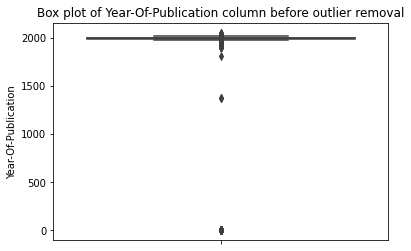

In [ ]:
# boxplot before handling outliers 
sns.boxplot(y='Year-Of-Publication', data=books)
plt.title('Box plot of Year-Of-Publication column before outlier removal')

In [ ]:
sorted_book_dates[:3]

[0, 1376, 1378]

In [ ]:
# book published during year 0 
books.loc[books['Year-Of-Publication']==sorted_book_dates[0]]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
176,3150000335,Kabale Und Liebe,Schiller,0,"Philipp Reclam, Jun Verlag GmbH"
188,342311360X,Die Liebe in Den Zelten,Gabriel Garcia Marquez,0,Deutscher Taschenbuch Verlag (DTV)
288,0571197639,Poisonwood Bible Edition Uk,Barbara Kingsolver,0,Faber Faber Inc
351,3596214629,"Herr Der Fliegen (Fiction, Poetry and Drama)",Golding,0,Fischer Taschenbuch Verlag GmbH
542,8845229041,Biblioteca Universale Rizzoli: Sulla Sponda De...,P Coelho,0,Fabbri - RCS Libri
...,...,...,...,...,...
270794,014029953X,Foe (Essential.penguin S.),J.M. Coetzee,0,Penguin Books Ltd
270913,0340571187,Postmens House,Maggie Hemingway,0,Trafalgar Square
271094,8427201079,El Misterio De Sittaford,Agatha Christie,0,Editorial Molino
271182,0887781721,Tom Penny,Tony German,0,P. Martin Associates


Well that just looks like a typo/error during data entry

In [ ]:
# book published in 1376
books.loc[books['Year-Of-Publication']==sorted_book_dates[1]]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
253750,964442011X,Tasht-i khun,IsmaÂ°il Fasih,1376,Nashr-i Alburz


[IsmaÂ°il Fasih's book - Tasht-i khun was published in the year - 1997](https://ferdosi.com/pages/product/?lang=en&product=0&id=964442011X&title=Tasht-i+khun&ntitle=%D8%B7%D8%B4%D8%AA+%D8%AE%D9%88%D9%86)

In [ ]:
books.loc[books['Year-Of-Publication']==sorted_book_dates[2]]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
227531,9643112136,Dalan-i bihisht (Dastan-i Irani),Nazi Safavi,1378,Intisharat-i Quqnus


[Nazi Safavi book - Dalan-i bihisht (Dastan-i Irani) was published in the year 1999](https://www.goodreads.com/author/show/5494214.Nazi_Safavi)

In [ ]:
# correcting years of books in dataset

# book - Tasht-i khun
books.loc[books['Year-Of-Publication']==sorted_book_dates[1], 'Year-Of-Publication'] = 1997
# book - Dalan-i bihisht (Dastan-i Irani)
books.loc[books['Year-Of-Publication']==sorted_book_dates[2], 'Year-Of-Publication'] = 1999

# replace the null and outliers with the mode(year-of-publication)
books.loc[(books['Year-Of-Publication'] > 2004) , 'Year-Of-Publication'] = 2002
books.loc[(books['Year-Of-Publication'] == 0), 'Year-Of-Publication'] = 2002

In [ ]:
# after cleaning - sorted dates
print(sorted(list(books['Year-Of-Publication'].unique())))

[1806, 1897, 1900, 1901, 1902, 1904, 1906, 1908, 1909, 1910, 1911, 1914, 1917, 1919, 1920, 1921, 1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932, 1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004]


Text(0.5, 1.0, 'Box plot of Year-Of-Publication column after removing outliers')

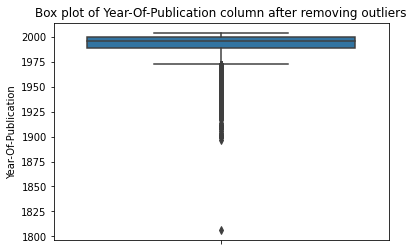

In [ ]:
# boxplot before handling outliers 
sns.boxplot(y='Year-Of-Publication', data=books)
plt.title('Box plot of Year-Of-Publication column after removing outliers')

after observing the unique years and the box plot we can confirm that our corrections have taken effect

Text(0.5, 1.0, 'Number of Books published each year ')

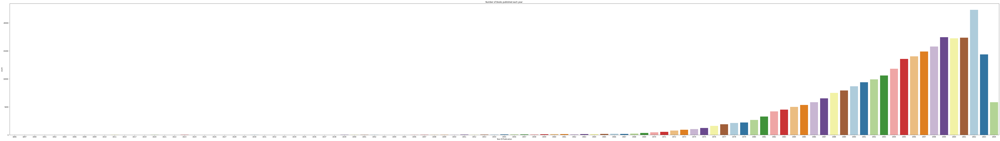

In [ ]:
  # plot the number of books published year-on-year
  plt.figure(figsize=(110,15))
  sns.countplot(x='Year-Of-Publication',data=books,palette='Paired')
  plt.title('Number of Books published each year ')

In [ ]:
# Upper casing all alphabets in ISBN
books['ISBN'] = books['ISBN'].str.upper()

In [ ]:
# Drop duplicate rows
books.drop_duplicates(keep='last', inplace=True) 
books.reset_index(drop = True, inplace = True)

# size of df after dropping
print(f'Shape of dataframe after dropping duplicates : {books.shape}')
print(f'Number of duplicates dropped are : {271360 - books.shape[0]}')

Shape of dataframe after dropping duplicates : (271047, 5)
Number of duplicates dropped are : 313


In [ ]:
# checking ISBN for special charecters
def specialCharDetector(d_frame,col_v):
  flag = 0
  reg = "[^A-Za-z0-9]"

  # loop through each item(isbn) in the given col
  for x in d_frame[col_v]:
      z = re.search(reg,x)    
      if z:
          flag = 1
  # if flag is set to 1 then there are special charecters
  if flag == 1:
      print(f" Special charecters found in {col_v}")
  else:
      print(f" No special charecters found in {col_v}")

In [ ]:
specialCharDetector(books,'ISBN')

 Special charecters found in ISBN


[but isbn mustn't contain special charecters ](http://www-math.ucdenver.edu/~wcherowi/jcorner/isbn.html)

In [ ]:
# removing extra characters from ISBN (from ratings dataset) existing in books dataset
def removeSpecialChar(df_):
  bookISBN = df_['ISBN'].tolist() 
  reg = "[^A-Za-z0-9]" 
  for index, row_Value in df_.iterrows():
      z = re.search(reg, row_Value['ISBN'])    
      if z:
          f = re.sub(reg,"",row_Value['ISBN'])
          if f in bookISBN:
              df_.at[index , 'ISBN'] = f

In [ ]:
# remove special charecters
# removeSpecialChar(books)

In [ ]:
# count plot values on required axis based off  on the dataframe
def CountPlotN(col,data,n,title,axis_flag=0):
  
  ''' count plot values on required axis
  axis_flag - specify axis-(0)=y_axis ; (1)=x_axis, 
  data - dataframe,
  n - select the topN values to be displaced
  title - specify the title to be displayed '''

  plt.figure(figsize=(15,7))
  order = pd.value_counts(data[col]).iloc[:n].index
  # change axis based on flag
  if axis_flag:
    sns.countplot(x=col,data=data,order=order,palette='Paired')
  else:
    sns.countplot(y=col,data=data,order=order,palette='Paired')
  plt.title(title)

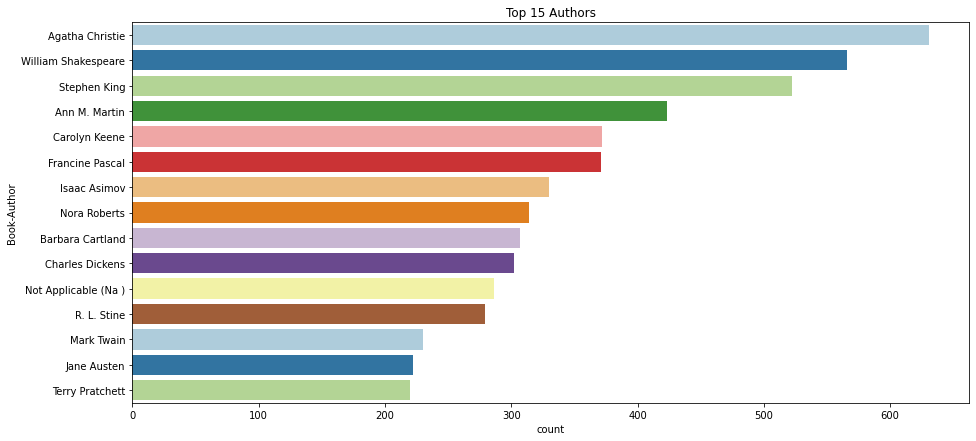

In [ ]:
# plot the author whose books were read the most
CountPlotN('Book-Author',books,15,'Top 15 Authors')

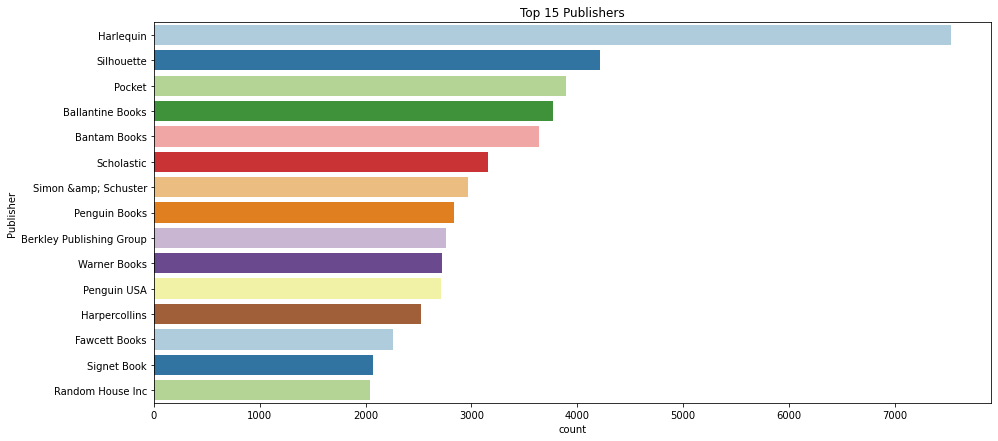

In [ ]:
# publishers whoose books were read by the most readers
CountPlotN('Publisher',books,15,'Top 15 Publishers')

### Users data cleaning

In [ ]:
# look at the users
users.head()

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [ ]:
# info
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278858 entries, 0 to 278857
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   User-ID   278858 non-null  int64  
 1   Location  278858 non-null  object 
 2   Age       168096 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 6.4+ MB


In [ ]:
print(f" Users dataset shape: {users.shape}")
print(f" Columns of users dataset : {list(users.columns)}")

 Users dataset shape: (278858, 3)
 Columns of users dataset : ['User-ID', 'Location', 'Age']


In [ ]:
# Checking for null values
print(users.isna().sum())   

User-ID          0
Location         0
Age         110762
dtype: int64


In [ ]:
# Check for all unique values present in Age column
print(sorted(list(users['Age'].unique())))

[nan, 0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0, 53.0, 54.0, 55.0, 56.0, 57.0, 58.0, 59.0, 60.0, 61.0, 62.0, 63.0, 64.0, 65.0, 66.0, 67.0, 68.0, 69.0, 70.0, 71.0, 72.0, 73.0, 74.0, 75.0, 76.0, 77.0, 78.0, 79.0, 80.0, 81.0, 82.0, 83.0, 84.0, 85.0, 86.0, 87.0, 88.0, 89.0, 90.0, 91.0, 92.0, 93.0, 94.0, 95.0, 96.0, 97.0, 98.0, 99.0, 100.0, 101.0, 102.0, 103.0, 104.0, 105.0, 106.0, 107.0, 108.0, 109.0, 110.0, 111.0, 113.0, 114.0, 115.0, 116.0, 118.0, 119.0, 123.0, 124.0, 127.0, 128.0, 132.0, 133.0, 136.0, 137.0, 138.0, 140.0, 141.0, 143.0, 146.0, 147.0, 148.0, 151.0, 152.0, 156.0, 157.0, 159.0, 162.0, 168.0, 172.0, 175.0, 183.0, 186.0, 189.0, 199.0, 200.0, 201.0, 204.0, 207.0, 208.0, 209.0, 210.0, 212.0, 219.0, 220.0, 223.0, 226.0

Text(0.5, 1.0, 'Distribution Plot of users age ')

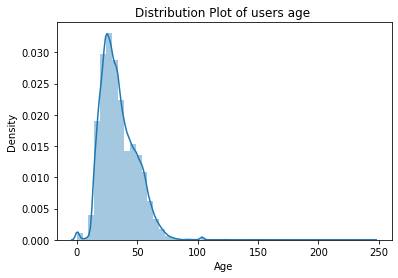

In [ ]:
# Dist Plot of users age
sns.distplot(users.Age)
plt.title('Distribution Plot of users age ')

In [ ]:
# CountPlotN('Age',users,len(users),'bal',1)

### From the above list we can see that there are outliers in the dataset(age)

Text(0.5, 1.0, 'Box plot of Age column before outlier removal')

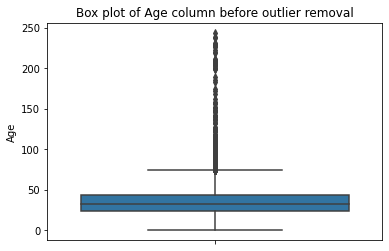

In [ ]:
# boxplot before handling outliers 
sns.boxplot(y='Age', data=users)
plt.title('Box plot of Age column before outlier removal')

In [ ]:
# claclulate the mean users age 
mean_user_age = round( users[(users['Age'] <= 90) & (users['Age'] >= 10)]['Age'].mean())
mean_user_age

35

In [ ]:
# outliers with age grater than 80 & age less than 10 years are substitued with mean users age
users.loc[(users['Age'] > 90) | (users['Age'] < 10 ), 'Age'] = mean_user_age
# filling null values with mean
users['Age'] = users['Age'].fillna(mean_user_age)     
# finally changing Datatype to int
users['Age'] = users['Age'].astype(int)       

In [ ]:
# double check to see if missing values are present
users['Age'].isna().sum()

0

Text(0.5, 1.0, 'Distribution Plot of users age after mean replacement')

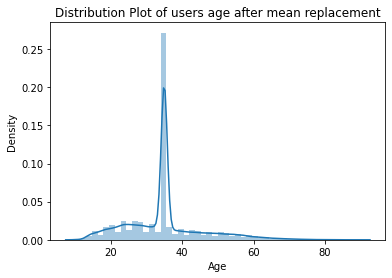

In [ ]:
# Dist Plot of users age after fillings missing values and treating outliers
sns.distplot(users.Age)
plt.title('Distribution Plot of users age after mean replacement')

Text(0.5, 1.0, 'Box plot of Age column after removing outliers')

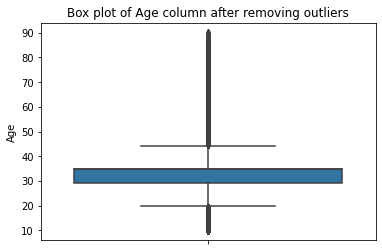

In [ ]:
# boxplot after handling outliers 
sns.boxplot(y='Age', data=users)
plt.title('Box plot of Age column after removing outliers')

In [ ]:
# CountPlotN('Age',users,len(users),'bal',1)

Well we have successfully handled the removal of all the existing null values in the age column

In [ ]:
# in the dataset allthe city-state-country are gropued together 
# the code below will help split these into their respective categorys and add them into the df as cols

# split users location
list_ = users.Location.str.split(', ')

# lists of city,state & country
city = []
state = []
country = []
count_no_state = 0    
count_no_country = 0

# remove invalid entries too
for i in range(0,len(list_)):
    if list_[i][0] == ' ' or list_[i][0] == '' or list_[i][0]=='n/a' or list_[i][0] == ',':  
        city.append('other')
    else:
        city.append(list_[i][0].lower())

    if(len(list_[i])<2):
        state.append('other')
        country.append('other')
        count_no_state += 1
        count_no_country += 1
    else:
        if list_[i][1] == ' ' or list_[i][1] == '' or list_[i][1]=='n/a' or list_[i][1] == ',': 
            state.append('other')
            count_no_state += 1            
        else:
            state.append(list_[i][1].lower())
        
        if(len(list_[i])<3):
            country.append('other')
            count_no_country += 1
        else:
            if list_[i][2] == ''or list_[i][1] == ',' or list_[i][2] == ' ' or list_[i][2] == 'n/a':
                country.append('other')
                count_no_country += 1
            else:
                country.append(list_[i][2].lower())

# drop the locations col
users = users.drop('Location',axis=1)

temp = []
for ent in city:
    # handling cases where city/state entries from city list as state is already given 
    c = ent.split('/')            
    temp.append(c[0])

# create respective dataframes
df_city = pd.DataFrame(temp,columns=['City'])
df_state = pd.DataFrame(state,columns=['State'])
df_country = pd.DataFrame(country,columns=['Country'])

# add these newly created df to users df
users = pd.concat([users, df_city], axis=1)
users = pd.concat([users, df_state], axis=1)
users = pd.concat([users, df_country], axis=1)

# printing the number of countries didnt have any values 
print(count_no_country) 
# printing the states which didnt have any   
print(count_no_state)     

4659
16044


In [ ]:
# Drop duplicate rows
users.drop_duplicates(keep='last', inplace=True)
users.reset_index(drop=True, inplace=True)

# size of df after dropping
print(f'Shape of dataframe after dropping duplicates : {users.shape}')
print(f'Number of duplicates dropped are : {278858 - users.shape[0]}')

Shape of dataframe after dropping duplicates : (278858, 5)
Number of duplicates dropped are : 0


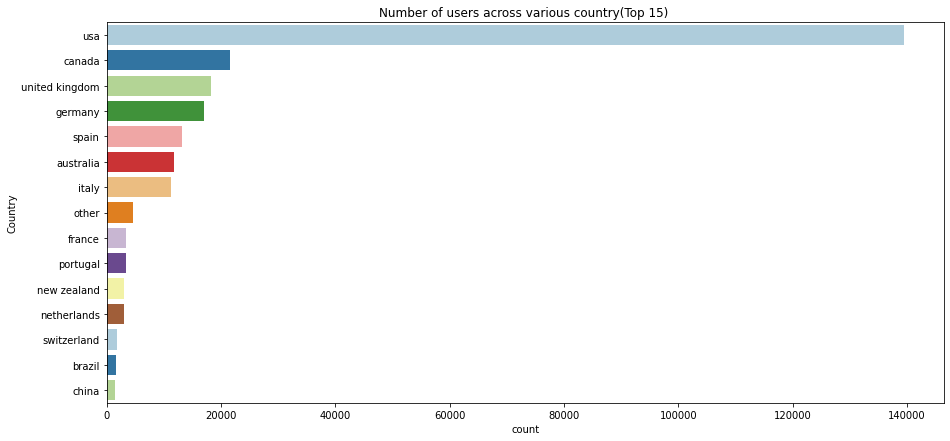

In [ ]:
# readers across various countries
CountPlotN('Country',users,15,'Number of users across various country(Top 15) ')

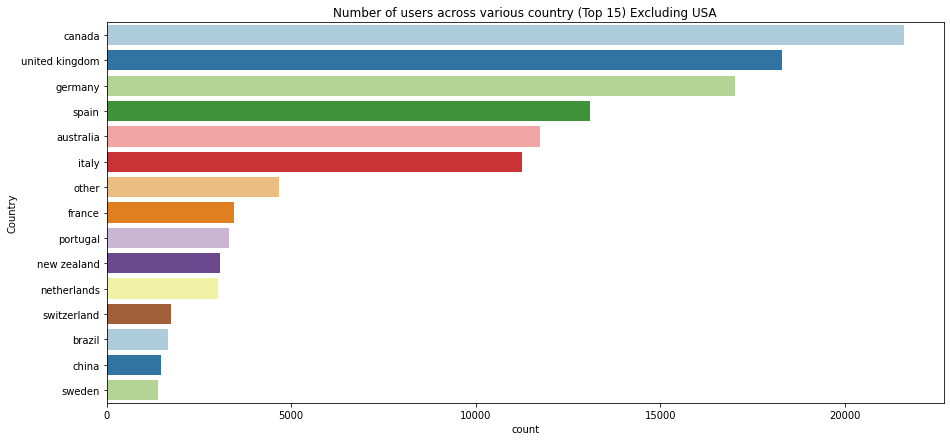

In [ ]:
# excluding USA
CountPlotN('Country',users[users['Country']!='usa'],15,'Number of users across various country (Top 15) Excluding USA')

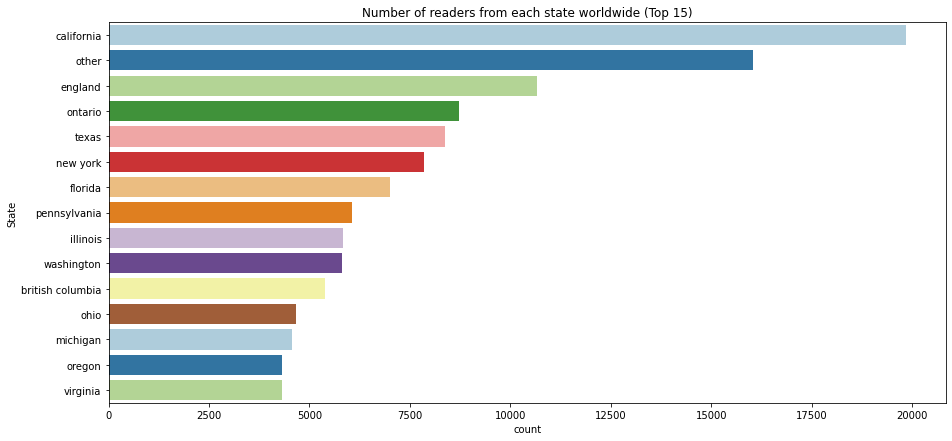

In [ ]:
# states with most readers globally
CountPlotN('State',users,15,'Number of readers from each state worldwide (Top 15)')

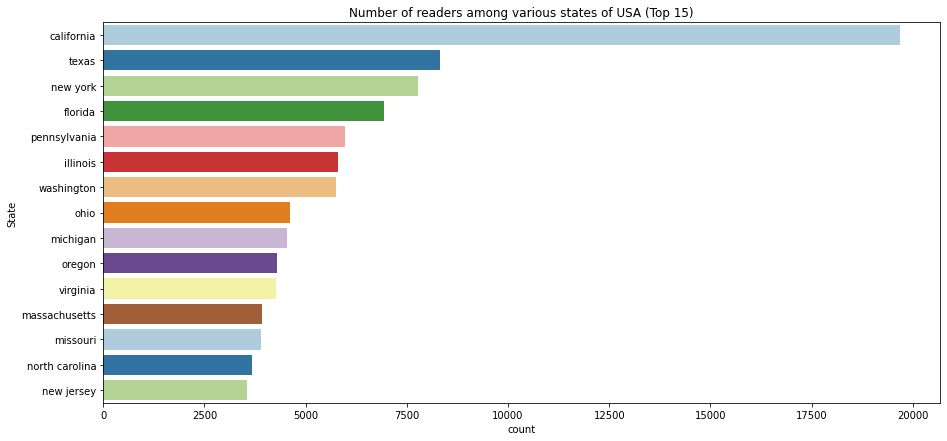

In [ ]:
# states with most readers statewise in usa
CountPlotN('State',users[users['Country']=='usa'],15,'Number of readers among various states of USA (Top 15)')

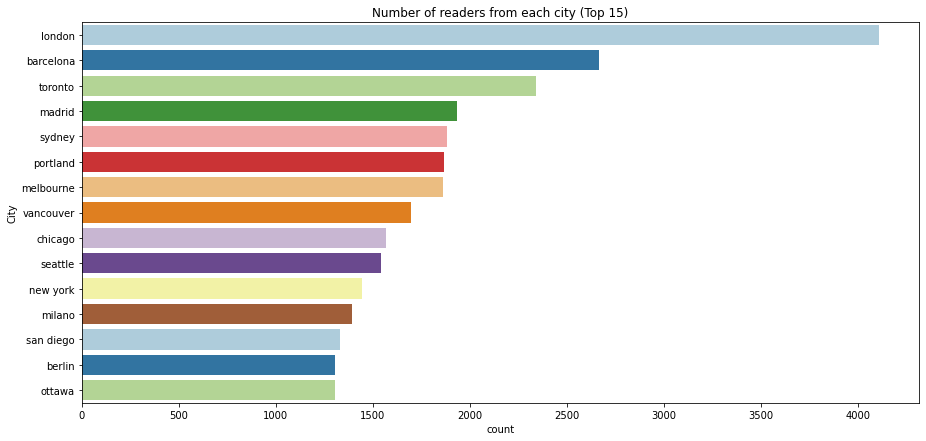

In [ ]:
# cities with most readers
CountPlotN('City',users,15,'Number of readers from each city (Top 15)')

### Ratings data cleaning

In [ ]:
# look at the ratings data
ratings.head()

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


In [ ]:
# info
ratings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1149780 entries, 0 to 1149779
Data columns (total 3 columns):
 #   Column       Non-Null Count    Dtype 
---  ------       --------------    ----- 
 0   User-ID      1149780 non-null  int64 
 1   ISBN         1149780 non-null  object
 2   Book-Rating  1149780 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 26.3+ MB


In [ ]:
print(f"Book-ratings Data : {ratings.shape}" )
print(f"Columns: {list(ratings.columns)}" )

Book-ratings Data : (1149780, 3)
Columns: ['User-ID', 'ISBN', 'Book-Rating']


In [ ]:
# Checking for null values
ratings.isnull().sum() 

User-ID        0
ISBN           0
Book-Rating    0
dtype: int64

In [ ]:
# checking User-ID & ratings contains only number or not
print(is_numeric_dtype(ratings['Book-Rating']))
print(is_numeric_dtype(ratings['User-ID']))

True
True


In [ ]:
# checking ISBN
specialCharDetector(ratings,'ISBN')

 Special charecters found in ISBN


In [ ]:
# remove special chars from isbn in ratings
# removeSpecialChar(ratings)

In [ ]:
# Uppercasing all alphabets in ISBN
ratings['ISBN'] = ratings['ISBN'].str.upper()

In [ ]:
# Drop duplicate rows
ratings.drop_duplicates(keep='last', inplace=True)
ratings.reset_index(drop=True, inplace=True)

# size of df after dropping
print(f'Shape of dataframe after dropping duplicates : {ratings.shape}')
print(f'Number of duplicates dropped are : {1149780 - ratings.shape[0]}')

Shape of dataframe after dropping duplicates : (1149780, 3)
Number of duplicates dropped are : 0


In [ ]:
# frequntly used rating value
# CountPlotN('Book-Rating',ratings,15,'most frequnt rating value')

the value for '0' seems to be dominant

In [ ]:
#Hence segragating implicit-0 and explict(~ 0) ratings datasets
non_zero_ratings = ratings[ratings['Book-Rating'] != 0]
zero_rating = ratings[ratings['Book-Rating'] == 0]

In [ ]:
# frequntly used rating value
# CountPlotN('Book-Rating',non_zero_ratings,15,'most frequnt rating value excluding zero')

### Merging of all three Tables
(Merging Books, Users and Rating Tables into One)

In [ ]:
# merging all three dataframes
df = pd.merge(books, non_zero_ratings, on='ISBN', how='inner')
df = pd.merge(df, users, on='User-ID', how='inner')
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 383892 entries, 0 to 383891
Data columns (total 11 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   ISBN                 383892 non-null  object
 1   Book-Title           383892 non-null  object
 2   Book-Author          383892 non-null  object
 3   Year-Of-Publication  383892 non-null  int64 
 4   Publisher            383892 non-null  object
 5   User-ID              383892 non-null  int64 
 6   Book-Rating          383892 non-null  int64 
 7   Age                  383892 non-null  int64 
 8   City                 383892 non-null  object
 9   State                383892 non-null  object
 10  Country              383892 non-null  object
dtypes: int64(4), object(7)
memory usage: 35.1+ MB


In [ ]:
# head of new dataframe
# df.head()

In [ ]:
# final check for null values across the new df
# df.isna().sum().sum()

## Recommender Systems

### 1. Popularity Based (Most-Read / Max-Rated)

In [ ]:
# fucntion that returns a df based on either on most read or most rated
def popularityBasedMaxR(data_frame, n,count_flag=0):
    # procedd only if n is greater than 0 and less than the df-length 
    if n >= 1 and n <= len(data_frame):
      # decide to take ratings sum or count 
      if count_flag :
        # grouop df on each ISBN, and count it's occurances
        series_data = data_frame.groupby('ISBN')['Book-Rating'].count()
      else:
        # group df on each ISBN, and add it's rating 
        series_data = data_frame.groupby('ISBN')['Book-Rating'].sum()
      # sort the values descendingly and create a new df - choose the number of items required
      data = pd.DataFrame(series_data).sort_values('Book-Rating', ascending=False).head(n)
      # merge the new dataframe and books df on ISBN
      result = pd.merge(data, books, on='ISBN', left_index = True)
      return result
    # incase of error
    return "Invalid number of books entered!!"

In [ ]:
# number of books to be recomended
recomm_number = 5 #int(input(" Enter number of books to be recommended : "))

In [ ]:
# book_rating_count = df.groupby('ISBN')['Book-Rating'].count()
print(f"Top {recomm_number} books based on most number of readers are: ")
popularityBasedMaxR(df, recomm_number,1)

Top 5 books based on most number of readers are: 


,ISBN,Book-Rating,Book-Title,Book-Author,Year-Of-Publication,Publisher
401,0316666343,707,The Lovely Bones: A Novel,Alice Sebold,2002,"Little, Brown"
26,0971880107,581,Wild Animus,Rich Shapero,2004,Too Far
734,0385504209,487,The Da Vinci Code,Dan Brown,2003,Doubleday
513,0312195516,383,The Red Tent (Bestselling Backlist),Anita Diamant,1998,Picador USA
1086,0060928336,320,Divine Secrets of the Ya-Ya Sisterhood: A Novel,Rebecca Wells,1997,Perennial


In [ ]:
# book_rating_sum = df.groupby('ISBN')['Book-Rating'].sum()
print(f"Top {recomm_number} books based on highest total ratings recieved are: ")
popularityBasedMaxR(df, recomm_number)

Top 5 books based on highest total ratings recieved are: 


,ISBN,Book-Rating,Book-Title,Book-Author,Year-Of-Publication,Publisher
401,0316666343,5787,The Lovely Bones: A Novel,Alice Sebold,2002,"Little, Brown"
734,0385504209,4108,The Da Vinci Code,Dan Brown,2003,Doubleday
513,0312195516,3134,The Red Tent (Bestselling Backlist),Anita Diamant,1998,Picador USA
77151,059035342X,2815,Harry Potter and the Sorcerer's Stone (Harry P...,J. K. Rowling,1999,Arthur A. Levine Books
352,0142001740,2595,The Secret Life of Bees,Sue Monk Kidd,2003,Penguin Books


Above two dataframes represent most read books and highest voted books although the first book seems to be common in both but we see that even though 'The Da Vinci Code' was read by less people compared to 'Wild Animus' it still holds the second spot on the most rated books whereas the book 'Wild Animus' itn't among the top 5 most rated books. further down the list we can see few differences among both the dataframes

### 2. Location Based (Most read/popular in the given location)

In [ ]:
# that searches for most read/most voted books in a region
def searchLocation(dataframe, place):
    ''' A function that takes in a Dataframe and placename, then is given out a
     dataframe that contains data of books based on the given location '''
    place = place.lower()
    # check for country
    if place in (dataframe['Country'].unique()):
        return dataframe[dataframe['Country'] == place]
    # check for state
    elif place in (dataframe['State'].unique()):
        return dataframe[dataframe['State'] == place]
    # check for city
    elif place in (dataframe['City'].unique()):
        return dataframe[dataframe['City'] == place]
    else:
        return "Invalid Entry"

In [ ]:
place = 'India' #input("Enter the name of place: ")
# place - examples India / USA or any Other country
data = searchLocation(df, place)

# check if data(location based df) is a dataframe
if not isinstance(data, pd.DataFrame):
    print('No books found in your specified area')
else:
    # run the popularity model based on most rated at given location
    data = popularityBasedMaxR(data, recomm_number,1)
    print(f'Highest Rated book(s) in {place} are : ')
data

Highest Rated book(s) in India are : 


,ISBN,Book-Rating,Book-Title,Book-Author,Year-Of-Publication,Publisher
26,0971880107,3,Wild Animus,Rich Shapero,2004,Too Far
166,0671047612,2,Skin And Bones,Franklin W. Dixon,2000,Aladdin
164,0486284735,2,Pride and Prejudice (Dover Thrift Editions),Jane Austen,1995,Dover Publications
9596,8171670407,2,Inscrutable Americans,Mathur Anurag,1996,South Asia Books
72379,0006944035,1,Secret Island / Secret Mountain (Two-in-ones),Enid Blyton,1994,HarperCollins Publishers


### 3. Books by Author or Publisher

In [ ]:
# print books of a dataframe
def printBook(k, n):
  ''' a function that prints n required books
      k - dataframe,
      n - number of top n elements '''
  # get a set of names of books present in the df(k)
  z = k['Book-Title'].unique()
  # loop through book titles and print them
  for x in range(len(z)):
        print(z[x])
        if x >= n-1:
            break

In [ ]:
# get books suggestions of pirticular author or publisher
def getBooks(dataframe, name, n, col_name):
  ''' taking a dataframe as input,name= bookname, 
      n = number of top n elements required,
      col_name = columns_name of author or publisher '''

  print(f"\nBooks by same {col_name}:\n")
  # a list of all authors/publishers for requested books
  name_list = dataframe[col_name].unique()
  # print('1')
  # exclude the requested book from suggestions
  data = df[df['Book-Title'] != name]
  # print('2')          
  # check if author/publisher name is in the dataframe
  if name_list[0] in data[col_name].unique(): 
    # a df(k) that contain books of chosen author/publisher
    k = data[data[col_name] == name_list[0]]
  # sort and print the df(k)
  k = k.sort_values(by=['Book-Rating'])
  printBook(k, n)

In [ ]:
bookName = " Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))" #input("Enter a book name: ")
# ex - Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))

# check if book exists in the set of book-titles
if bookName in list(df['Book-Title'].unique()):
    # send a df of the requested book
    d = df[df['Book-Title'] == bookName]
    # loop the function and print out publishers and authors
    for col_name in ['Book-Author', 'Publisher']:
      getBooks(d, bookName, recomm_number, col_name)
      print('-'*30)
else:
    # in case the requested book does not exist in the dataset
    print("Oops!! the requested book does not seem to be present ")


Oops!! the requested book does not seem to be present 


### 4. Books by Yearly popularity


In [ ]:
# data = pd.DataFrame(df.groupby('ISBN')['Book-Rating'].count()).sort_values('Book-Rating', ascending=False)
# data = pd.merge(data, books, on='ISBN', left_index = True)

# display all columns and rows
pd.set_option("display.max_rows", None, "display.max_columns", None)
# selecting book with most ratings at the top
max_rating_df = popularityBasedMaxR(df, len(df),1)

years = set()
indices = []
# loop through the max-rating df
for ind, row in max_rating_df.iterrows():
    # append to indices if the publication-year is found in years-list
    if row['Year-Of-Publication'] in years:
        indices.append(ind)
    else:
        # add to years
        years.add(row['Year-Of-Publication'])

# sort and restructure df based on publication-year
data = max_rating_df.drop(indices)
data = data.drop('Book-Rating', axis = 1)
data = data.sort_values('Year-Of-Publication')

print('Most Popular books across various years are :')
data

Most Popular books across various years are :


,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
171529,0781228956,"Complete Works 10 Volumes [2,6,7,8,9] (Notable...",Benjamin Franklin,1806,Reprint Services Corp
211547,1551103982,The Cycling Adventures of Coconut Head: A Nort...,Ted Schredd,1900,Graphic Arts Center Pub Co
264437,0671825356,W D HSE PLANTS,Jd Hersey,1901,Simon &amp; Schuster
102242,0373226888,Tommy's Mom,Linda O. Johnston,1902,Harlequin
45599,038528120X,CATCH 22,JOSEPH HELLER,1904,Delta
170683,0404089119,Charlotte Bronte and Her Sisters,Clement K. Shorter,1906,Ams Pr
159472,0911662251,Kybalion: A Study of the Hermetic Philosophy o...,Three Initiates,1908,Yoga Publication Society
172745,0891908994,Bitter Winds of Love,Barbara Cartland,1911,Amereon Ltd
8369,0684717603,The GREAT GATSBY (Scribner Classic),F. Scott Fritzgerald,1920,Scribner Paper Fiction
108044,0440772095,RAMONA THE PEST (Ramona Quimby (Paperback)),BEVERLY CLEARY,1923,Yearling


The above dataframe consists of data of various books,authors,publishers who have recieved the highest ratings in the pirticular year thus this data can be usefull if there were to be a pattern set in the data, that could further increase the sales of a pirticular books

### 5. Books by Average Weighted Ratings

In the above cases we have seen models that rank books on either the number of readers or the most rated ones this model is an extension of that to ensure that instead of soley relying on one we can use the weighted average concept to make a better model

In [ ]:
# create a copy of df(average rating df)
avg_r_df = df.copy()
# calculate the average ratings
avg_r_df['Average Rating']=df.groupby('ISBN')['Book-Rating'].transform('mean')
# calculate the total ratings given every book
avg_r_df['Total-Ratings']=avg_r_df.groupby('ISBN')['Book-Rating'].transform('count')
# show average-rating-dataframe
avg_r_df.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,User-ID,Book-Rating,Age,City,State,Country,Average Rating,Total-Ratings
0,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,8,5,35,timmins,ontario,canada,7.666667,9
1,074322678X,Where You'll Find Me: And Other Stories,Ann Beattie,2002,Scribner,8,5,35,timmins,ontario,canada,5.000000,1
2,0887841740,The Middle Stories,Sheila Heti,2004,House of Anansi Press,8,5,35,timmins,ontario,canada,5.000000,1
3,1552041778,Jane Doe,R. J. Kaiser,1999,Mira Books,8,5,35,timmins,ontario,canada,5.000000,1
4,1567407781,The Witchfinder (Amos Walker Mystery Series),Loren D. Estleman,1998,Brilliance Audio - Trade,8,6,35,timmins,ontario,canada,6.000000,1


In [ ]:
# mean_ratin - Mean vote across the whole
mean_ratin = avg_r_df['Average Rating'].mean()

# Minimum number of votes required to be in the chart
# choose the top 90 percentile of the data
m = avg_r_df['Total-Ratings'].quantile(0.90)
print(f'C={mean_ratin} , m={m}')

# choosing total ratings in dataset greater than the 90th percentile
avg_r_90_percent = avg_r_df.loc[avg_r_df['Total-Ratings'] >= m]
# print the average-rating-dataframe 90th percentile
print(f'The data shape of average ratings df before slicinng based on 90 percentile {avg_r_df.shape} after slicing {avg_r_90_percent.shape}')

C=7.626762214372647 , m=65.0
The data shape of average ratings df before slicinng based on 90 percentile (383892, 13) after slicing (38502, 13)


In [ ]:
# calc the weighted average of books 
def weightedRating(x, m=m, C=mean_ratin): 
    ''' returns weighted avarage of items, taken is x = dataframe,
        m = top 90 percentile data, c = mean-rating of the dataset'''
    #  v - number of votes
    v = x['Total-Ratings'] 
    # R - Average Rating     
    R = x['Average Rating']   
    return (v/(v+m) * R) + (m/(m+v) * C)

In [ ]:
# calc score(weighted_average)
avg_r_90_percent['Score'] = avg_r_90_percent.apply(weightedRating, axis=1)
# sort based on the best ones(highest-weighted-avg)
avgwr_df = avg_r_90_percent.drop_duplicates('ISBN').sort_index()
#Sorting books based on score calculated above
avgwr_df = avgwr_df.sort_values('Score', ascending=False)
recomm_number =5
print("Book recommendation based of on Weighted Average ratings :-\n")
# choose the required nummber of books
avgwr_df[['Book-Title', 'Total-Ratings', 'Average Rating', 'Score']].reset_index(drop=True).head(recomm_number)

# avgwr_df.shape

Book recommendation based of on Weighted Average ratings :-



,Book-Title,Total-Ratings,Average Rating,Score
0,Harry Potter and the Goblet of Fire (Book 4),137,9.262774,8.736334
1,Harry Potter and the Sorcerer's Stone (Harry P...,315,8.936508,8.712472
2,Harry Potter and the Order of the Phoenix (Boo...,207,9.038647,8.701248
3,To Kill a Mockingbird,214,8.943925,8.637059
4,Harry Potter and the Prisoner of Azkaban (Book 3),133,9.082707,8.604745


### 7. Correlation Based Filtering

In [ ]:
# set threshold
minimum_threshold = 50
# how many books a pirticular user has read
user_count = df['User-ID'].value_counts()
# choose users who have read more than 50 books
data = df[df['User-ID'].isin(user_count[user_count >= minimum_threshold].index)]
# number of times a book was rated
rat_count = data['Book-Rating'].value_counts()
# choose books that have read more than 50 ratings
data = data[data['Book-Rating'].isin(rat_count[rat_count >= minimum_threshold].index)]

# create a pivot table using bookratings
matrix = data.pivot_table(index='User-ID', columns='ISBN', values = 'Book-Rating').fillna(0)
# print('the created Pivot Table of users vs boooks(isbn) using book-ratings')
# matrix

In [ ]:
# calculate average rating
average_rating = pd.DataFrame(df.groupby('ISBN')['Book-Rating'].mean())
average_rating['ratingCount'] = pd.DataFrame(ratings.groupby('ISBN')['Book-Rating'].count())
average_rating.sort_values('ratingCount', ascending=False).head()

,Book-Rating,ratingCount
ISBN,,
0971880107,4.390706,2502
0316666343,8.185290,1295
0385504209,8.435318,883
0060928336,7.887500,732
0312195516,8.182768,723


In [ ]:
# for given book name find isbn
isbn = books.loc[books['Book-Title'] == bookName].reset_index(drop = True).iloc[0]['ISBN']
# find the isbn in the pivot-table(matrix)
row = matrix[isbn]
# find correlation(pearson's) with others in the matrix 
correlation = pd.DataFrame(matrix.corrwith(row), columns = ['Pearson Corr'])
# join the correlation df with average df
corr = correlation.join(average_rating['ratingCount'])

# sort values based on pearson correlation val - choose top 5
res = corr.sort_values('Pearson Corr', ascending=False).head(recomm_number+1)[1:].index
# merge this resilt with books df 
corr_books = pd.merge(pd.DataFrame(res, columns = ['ISBN']), books, on='ISBN')
print("\n Recommended Books using Correlation based filtering: \n")
corr_books

IndexError: ignored

### 6. Collaborative Filtering (delete)

User-Item based filtering

Upto this point we have used models that only consider wither ratings or users as its sole recommending criteria now lets branch out to an even more sophisticated model that compares users-items and then provides suggestions

In [ ]:
# drop unwanted cols 
required_df = avg_r_df.drop(['Year-Of-Publication','Publisher','Age','City','State','Country'], axis=1)

# set a threshold 
popularity_threshold = 50
# choose only books those have their total-rating above 50
popular_book = required_df[required_df['Total-Ratings'] >= popularity_threshold]
# reset the indedices as books below threshold were dropped
popular_book = popular_book.reset_index(drop = True)

In [ ]:
# create a test df
testdf = pd.DataFrame()

# based on respective book group all the users and ratings given to it
testdf = popular_book[['User-ID','Book-Rating']].groupby(popular_book['ISBN'])
# testdf.head()

# list that contain dicts(Users & Ratings)
listOfDictonaries=[]
# pointers and their mapping to ISBN's
indexMap = {}
# the reverse mapping of indexMap
reverseIndexMap = {}
# counter/pointer
ptr=0

# loop each isbn(gropkey) in the testdf
for groupKey in testdf.groups.keys():
    # temporary storing of each book's users and ratingvalue
    tempDict={}
    # assign all common users and ratings for an ISBN
    groupDF = testdf.get_group(groupKey)

    for i in range(0,len(groupDF)):
        # in temp dict for a pirticular book make the user as key and rating as value
        tempDict[groupDF.iloc[i,0]] = groupDF.iloc[i,1]
    # map pointer as key and ISBN as value
    indexMap[ptr]=groupKey
    reverseIndexMap[groupKey] = ptr
    # increment pointer after each ISBN
    ptr=ptr+1
    # append users and rating for each isbn
    listOfDictonaries.append(tempDict)

# instance of DictVectorizer
dictVectorizer = DictVectorizer(sparse=True)
# Transforms lists of feature-value mappings to vectors
vector = dictVectorizer.fit_transform(listOfDictonaries)
# calcluate cosie similarity of vector # dot prod
pairwiseSimilarity = cosine_similarity(vector)

In [ ]:
# print book names
def printBookDetails(bookID):
    # match isbn and print the repective name
    print(df[df['ISBN']==bookID]['Book-Title'].values[0])


#  get top recommendations
def getTopRecommandations(bookID):
    # a list of movie names
    collaborative = []
    # get the index of given book ISBN
    row = reverseIndexMap[bookID]
    # print the given book detail
    print("Input Book:")
    printBookDetails(bookID)
    
    print("\nRECOMMENDATIONS:\n")
    
    count = 0
    # a list of similar books
    similar = []
    # for the given index(row) in array(pairwise similarites) return similar indices
    for i in np.argsort(pairwiseSimilarity[row])[:-2][::-1]:
          # proceed if the index(i) isnt in similar
          if df[df['ISBN']==indexMap[i]]['Book-Title'].values[0] not in similar:
                # break if the count exceeds the required number of books
                if count>=recomm_number:
                      break
                count+=1
                # else append title into similar and colabrative lists
                book_title = df[df['ISBN']==indexMap[i]]['Book-Title'].values[0]
                similar.append(book_title)
                collaborative.append(book_title)
                printBookDetails(indexMap[i])

    # return list of books
    return collaborative

In [ ]:
# list of titles
k = list(df['Book-Title'])
# list of book ids
m = list(df['ISBN'])

bookName = "Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))"#input("Enter a book name: ")
# ex - Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))

# check if book exists in the set of book-titles
if bookName in k:
  print(f'The top {recomm_number} recomendations based on input using Colabrative Filtering \n')
  collaborative = getTopRecommandations(m[k.index(bookName)])
else:
  # in case the requested book does not exist in the dataset
  print("Oops!! the requested book does not seem to be present ")

The top 5 recomendations based on input using Colabrative Filtering 

Input Book:
Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))

RECOMMENDATIONS:

Harry Potter and the Prisoner of Azkaban (Book 3)
Harry Potter and the Goblet of Fire (Book 4)
Harry Potter and the Order of the Phoenix (Book 5)
Harry Potter and the Chamber of Secrets (Book 2)
Anne of Green Gables (Anne of Green Gables Novels (Paperback))


### 8. Nearest Neighbours Based Filtering (delete)

In [ ]:
# group data on title with the no of times rated
data = (df.groupby(by = ['Book-Title'])['Book-Rating'].count().reset_index().
        rename(columns = {'Book-Rating': 'Total-Rating'})[['Book-Title', 'Total-Rating']])

# merge this on df
result = pd.merge(data, df, on='Book-Title', left_index = True)
# select items above the threshold (50)
result = result[result['Total-Rating'] >= popularity_threshold]
result = result.reset_index(drop = True)
# create a pivot table using bookratings
matrix = result.pivot_table(index = 'Book-Title', columns = 'User-ID', values = 'Book-Rating').fillna(0)
# create a sparse row matrix
up_matrix = csr_matrix(matrix)
up_matrix

<652x24863 sparse matrix of type '<class 'numpy.float64'>'
	with 65131 stored elements in Compressed Sparse Row format>

In [ ]:
# nearest neighbours model 
# ['chebyshev', 'cityblock', 'euclidean', 'infinity', 'l1', 'l2', 'manhattan', 'minkowski', 'p',cosine]
model = NearestNeighbors(metric = 'cosine', algorithm = 'brute')
model.fit(up_matrix)

# for the given book name find nearest-neighbours
distances, indices = model.kneighbors(matrix.loc[bookName].values.reshape(1, -1), n_neighbors = recomm_number+1)
print("\nRecommended books using Nearest Neighbours:\n")
# based off on distance print the book names
for i in range(0, len(distances.flatten())):
    # skip for value 0 as it's the same book
    if i > 0:
        print(matrix.index[indices.flatten()[i]]) 


Recommended books using Nearest Neighbours:

Harry Potter and the Chamber of Secrets (Book 2)
Harry Potter and the Prisoner of Azkaban (Book 3)
Harry Potter and the Goblet of Fire (Book 4)
Harry Potter and the Order of the Phoenix (Book 5)
The Fellowship of the Ring (The Lord of the Rings, Part 1)


### 9. Content Based Filtering (delete)


In [ ]:
popularity_threshold = 80
# choose books with total ratings above 80 and reset indicies
popular_book = required_df[required_df['Total-Ratings'] >= popularity_threshold]
popular_book = popular_book.reset_index(drop = True)
popular_book.shape

(31163, 7)

In [ ]:
# extract unigrams and bigrams and cutoff document below threshold finally remove stopwords
tf = TfidfVectorizer(ngram_range=(1, 2), min_df = 1, stop_words='english')
# fit on title
tfidf_matrix = tf.fit_transform(popular_book['Book-Title'])
tfidf_matrix.shape

(31163, 911)

In [ ]:
# typecast to float 32
normalized_df = tfidf_matrix.astype(np.float32)
# find cosine similarity between values
cosine_similarities = cosine_similarity(normalized_df, normalized_df)
cosine_similarities.shape

(31163, 31163)

In [ ]:
print("Recommended Books using Content:\n")
# get isbn from bookname
isbn = books.loc[books['Book-Title'] == bookName].reset_index(drop = True).iloc[0]['ISBN']
# list of content based recommended books  
content = []
# find index of book
idx = popular_book.index[popular_book['ISBN'] == isbn].tolist()[0]
# find similar indicies
similar_indices = cosine_similarities[idx].argsort()[::-1]
similar_items = []
# loop theough indices
for i in similar_indices:
    # enter if block only if the found book's names isn't the original name and isnt present in similar items and  len of similar_items is less than the requies number of books
    if popular_book['Book-Title'][i] != bookName and popular_book['Book-Title'][i] not in similar_items and len(similar_items) < recomm_number:
        # append the bookname to 2 lists
        similar_items.append(popular_book['Book-Title'][i])
        content.append(popular_book['Book-Title'][i])

# print similar books
for book in similar_items:
    print(book)

Recommended Books using Content:

Harry Potter and the Sorcerer's Stone (Book 1)
Harry Potter and the Goblet of Fire (Book 4)
Harry Potter and the Chamber of Secrets (Book 2)
Harry Potter and the Prisoner of Azkaban (Book 3)
Harry Potter and the Order of the Phoenix (Book 5)


### 10. Hybrid Approach (Content and Collaborative) (delete)

In [ ]:
z = list()
k = float(1/recomm_number)
for x in range(recomm_number):
      z.append(1-k*x)

dictISBN = {}
for x in collaborative:
      dictISBN[x] = z[collaborative.index(x)]

for x in content:
    if x not in dictISBN:
        dictISBN[x] = z[content.index(x)]
    else:
        dictISBN[x] += z[content.index(x)]

ISBN = dict(sorted(dictISBN.items(),key=operator.itemgetter(1),reverse=True))
w=0
print("Input Book:\n")
print(bookName)
print("\nRecommended Books:\n")
for x in ISBN.keys():
    if w>=recomm_number:
        break
    w+=1
    print(x)

Input Book:

Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))

Recommended Books:

Harry Potter and the Goblet of Fire (Book 4)
Harry Potter and the Prisoner of Azkaban (Book 3)
Harry Potter and the Sorcerer's Stone (Book 1)
Harry Potter and the Chamber of Secrets (Book 2)
Harry Potter and the Order of the Phoenix (Book 5)


Colabrative - model-memory, user item interaction
Content based - item attributes

#. Model Based Collaborative Filtering Recommender

In [ ]:
avg_r_df.shape

(383892, 13)

In [ ]:
ratings_explicit = avg_r_df.copy()

In [ ]:
ratings_explicit = ratings_explicit[['ISBN','User-ID','Book-Rating','Average Rating','Total-Ratings']]

In [ ]:
ratings_explicit.rename(columns = {'ISBN':'isbn' ,'User-ID':'user_id','Book-Rating':'book_rating','Average Rating':'Avg_Rating','Total-Ratings':'Total_No_Of_Users_Rated'},inplace=True)


In [ ]:
ratings_explicit.head()

,isbn,user_id,book_rating,Avg_Rating,Total_No_Of_Users_Rated
0,0002005018,8,5,7.666667,9
1,074322678X,8,5,5.000000,1
2,0887841740,8,5,5.000000,1
3,1552041778,8,5,5.000000,1
4,1567407781,8,6,6.000000,1


To reduce the dimensionality of the dataset and avoid running into memory error we will focus on users with at least 3 ratings and top 10% most frequently rated books.

In [ ]:
user_ratings_threshold = 3

filter_users = ratings_explicit['user_id'].value_counts()
filter_users_list = filter_users[filter_users >= user_ratings_threshold].index.to_list()

df_ratings_top = ratings_explicit[ratings_explicit['user_id'].isin(filter_users_list)]

print('Filter: users with at least %d ratings\nNumber of records: %d' % (user_ratings_threshold, len(df_ratings_top)))

Filter: users with at least 3 ratings
Number of records: 327319


In [ ]:
book_ratings_threshold_perc = 0.1
book_ratings_threshold = len(df_ratings_top['isbn'].unique()) * book_ratings_threshold_perc

filter_books_list = df_ratings_top['isbn'].value_counts().head(int(book_ratings_threshold)).index.to_list()
df_ratings_top = df_ratings_top[df_ratings_top['isbn'].isin(filter_books_list)]

print('Filter: top %d%% most frequently rated books\nNumber of records: %d' % (book_ratings_threshold_perc*100, len(df_ratings_top)))

Filter: top 10% most frequently rated books
Number of records: 160871


In [ ]:
df_ratings_top.shape

(160871, 5)

SVD and NMF models comparison<br>
Singular Value Decomposition (SVD) and Non-negative Matrix Factorization (NMF) are matrix factorization techniques used for dimensionality reduction. Surprise package provides implementation of those algorithms.

In [ ]:
pip install surprise

     |████████████████████████████████| 11.8 MB 4.7 MB/s 
  Created wheel for scikit-surprise: filename=scikit_surprise-1.1.1-cp37-cp37m-linux_x86_64.whl size=1619433 sha256=d923aa787e54bb192960f408b49bcacba03daae3dfd6a98d00f553a6592ecea9
  Stored in directory: /root/.cache/pip/wheels/76/44/74/b498c42be47b2406bd27994e16c5188e337c657025ab400c1c
Successfully built scikit-surprise


In [ ]:
from surprise import Dataset, Reader
from surprise import SVD, NMF
from surprise.model_selection import cross_validate, train_test_split, GridSearchCV

In [ ]:
df=df_ratings_top.copy()
reader = Reader(rating_scale=(1, 10))
data = Dataset.load_from_df(df[['user_id', 'isbn', 'book_rating']], reader)

In [ ]:
df_ratings_top.shape

(160871, 5)

In [ ]:
model_svd = SVD()
cv_results_svd = cross_validate(model_svd, data, cv=3)
pd.DataFrame(cv_results_svd).mean()

test_rmse    1.603716
test_mae     1.240914
fit_time     6.974409
test_time    0.602086
dtype: float64

In [ ]:
model_nmf = NMF()
cv_results_nmf = cross_validate(model_nmf, data, cv=3)
pd.DataFrame(cv_results_nmf).mean()

test_rmse     2.622297
test_mae      2.238863
fit_time     11.509666
test_time     0.588755
dtype: float64

It's clear that for the given dataset much better results can be obtained with SVD approach - both in terms of accuracy and training / testing time.

<h2>Optimisation of SVD algorithm

In [ ]:
param_grid = {'n_factors': [80,100],
              'n_epochs': [5, 20],
              'lr_all': [0.002, 0.005],
              'reg_all': [0.2, 0.4]}

gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
gs.fit(data)

print(gs.best_score['rmse'])
print(gs.best_params['rmse'])

1.5973599738744628
{'n_factors': 80, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.2}


In [ ]:
trainset, testset = train_test_split(data, test_size=0.2)

model = SVD(n_factors=80, n_epochs=20, lr_all=0.005, reg_all=0.2)
model.fit(trainset)
predictions = model.test(testset)

In [ ]:
df_pred = pd.DataFrame(predictions, columns=['user_id', 'isbn', 'actual_rating', 'pred_rating', 'details'])
df_pred['impossible'] = df_pred['details'].apply(lambda x: x['was_impossible'])
df_pred['pred_rating_round'] = df_pred['pred_rating'].round()
df_pred['abs_err'] = abs(df_pred['pred_rating'] - df_pred['actual_rating'])
df_pred.drop(['details'], axis=1, inplace=True)
df_pred.sample(10)

,user_id,isbn,actual_rating,pred_rating,impossible,pred_rating_round,abs_err
1067,171445,0060987529,5.0,7.753673,False,8.0,2.753673
15880,81560,0553293354,9.0,7.751031,False,8.0,1.248969
1625,164323,0394758285,9.0,8.144843,False,8.0,0.855157
7188,23768,0446530522,8.0,8.209715,False,8.0,0.209715
13467,6073,0156658992,9.0,8.200343,False,8.0,0.799657
26579,261829,0515106402,8.0,7.834864,False,8.0,0.165136
6978,230581,0671741454,7.0,7.366194,False,7.0,0.366194
15450,126492,0064408655,10.0,8.279399,False,8.0,1.720601
12435,136071,0684848783,9.0,8.593189,False,9.0,0.406811
31726,80810,051513449X,10.0,8.218461,False,8.0,1.781539


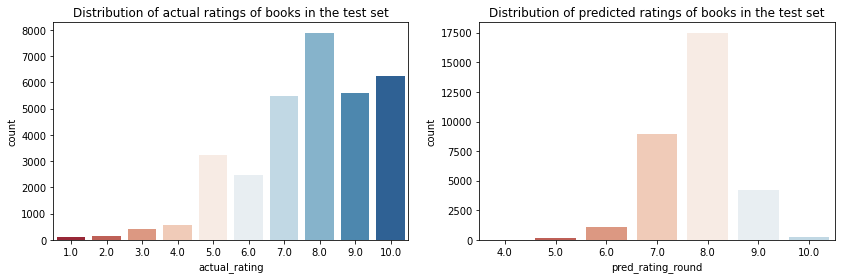

In [ ]:
palette = sns.color_palette("RdBu", 10)
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14, 4))

sns.countplot(x='actual_rating', data=df_pred, palette=palette, ax=ax1)
ax1.set_title('Distribution of actual ratings of books in the test set')

sns.countplot(x='pred_rating_round', data=df_pred, palette=palette, ax=ax2)
ax2.set_title('Distribution of predicted ratings of books in the test set')

plt.show()

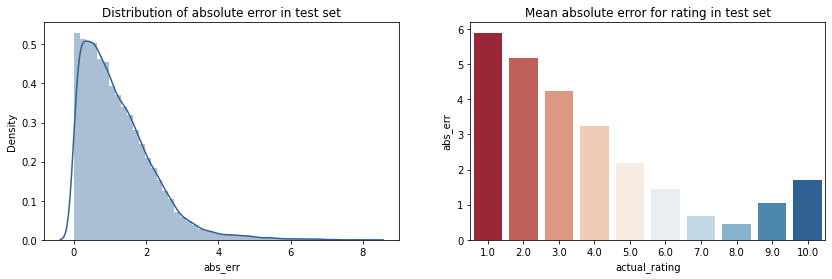

In [ ]:
df_pred_err = df_pred.groupby('actual_rating')['abs_err'].mean().reset_index()

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(14, 4))

sns.distplot(df_pred['abs_err'], color='#2f6194', ax=ax1)
ax1.set_title('Distribution of absolute error in test set')

sns.barplot(x='actual_rating', y='abs_err', data=df_pred_err, palette=palette, ax=ax2)
ax2.set_title('Mean absolute error for rating in test set')

plt.show()

In [ ]:
df_books = books.copy()
df_books.rename(columns = {'ISBN':'isbn' ,'Book-Title':'book_title'},inplace=True)

In [ ]:
df_ext = df.merge(df_books[['isbn', 'book_title']], on='isbn', how='left')

In [ ]:
df_ext.head()

,isbn,user_id,book_rating,Avg_Rating,Total_No_Of_Users_Rated,book_title
0,0002005018,8,5,7.666667,9,Clara Callan
1,0002005018,11676,8,7.666667,9,Clara Callan
2,0399135782,11676,9,8.176471,17,The Kitchen God's Wife
3,0440234743,11676,9,7.704142,169,The Testament
4,0452264464,11676,8,7.772152,79,Beloved (Plume Contemporary Fiction)


In [ ]:
df_ext = df_ext.merge(df_pred[['isbn', 'user_id', 'pred_rating']], on=['isbn', 'user_id'], how='left')

In [ ]:
df_ext.shape

(160971, 7)

###Train set: Top rated books

In [ ]:
selected_user_id = 193458
df_user = df_ext[df_ext['user_id']==selected_user_id]
df_user[(df_user['pred_rating'].isna())&(df_user['book_rating']>=9)].sample(10)

,isbn,user_id,book_rating,Avg_Rating,Total_No_Of_Users_Rated,book_title,pred_rating
48631,0140298479,193458,9,7.539823,113,Bridget Jones: The Edge of Reason,NaN
48652,0064471098,193458,9,8.733333,15,The Silver Chair,NaN
48659,0064471055,193458,9,8.545455,22,Prince Caspian (rack) : The Return to Narnia (...,NaN
48622,0142001740,193458,9,8.452769,307,The Secret Life of Bees,NaN
48626,0140620125,193458,9,8.133333,15,Wuthering Heights (Penguin Popular Classics),NaN
48629,0345361792,193458,10,8.607735,181,A Prayer for Owen Meany,NaN
48644,0671880314,193458,9,8.305556,36,Schindler's List,NaN
48671,1853260169,193458,10,8.153846,13,Sense and Sensibility (Wordsworth Classics),NaN
48648,0330352695,193458,9,7.615385,13,Four Letters of Love,NaN
48658,0064471063,193458,9,8.518519,27,The Horse and His Boy,NaN



####Test set: predicted top rated books

In [ ]:
df_user[df_user['pred_rating'].notna()].sort_values('pred_rating', ascending=False).head(5)

,isbn,user_id,book_rating,Avg_Rating,Total_No_Of_Users_Rated,book_title,pred_rating
48660,0064471071,193458,9,8.733333,15,The Voyage of the Dawn Treader (rack) (Narnia),8.328186
48650,006447108X,193458,9,8.833333,18,The Last Battle,8.254163
48624,0345424719,193458,8,8.017544,57,A Widow for One Year,8.061118
48653,0345431057,193458,9,9.125000,8,Slaves in the Family (Ballantine Reader's Circle),8.050840
48637,0446611808,193458,5,7.820000,50,Envy,7.990471


####Test set: actual top rated books

In [ ]:
df_user[df_user['pred_rating'].notna()].sort_values('book_rating', ascending=False).head(5)

,isbn,user_id,book_rating,Avg_Rating,Total_No_Of_Users_Rated,book_title,pred_rating
48619,0679429220,193458,9,7.794393,107,Midnight in the Garden of Good and Evil: A Sav...,7.820859
48650,006447108X,193458,9,8.833333,18,The Last Battle,8.254163
48653,0345431057,193458,9,9.125000,8,Slaves in the Family (Ballantine Reader's Circle),8.050840
48660,0064471071,193458,9,8.733333,15,The Voyage of the Dawn Treader (rack) (Narnia),8.328186
48620,0671042858,193458,8,7.063158,95,The Girl Who Loved Tom Gordon,7.495271


In [ ]:
from sklearn.neighbors import NearestNeighbors
from scipy.spatial.distance import correlation
from sklearn.metrics.pairwise import pairwise_distances
import ipywidgets as widgets
from IPython.display import display, clear_output
from contextlib import contextmanager
import numpy as np
import os, sys
import re
from scipy.sparse import csr_matrix

In [ ]:
df_ratings_top.head()

,isbn,user_id,book_rating,Avg_Rating,Total_No_Of_Users_Rated
0,0002005018,8,5,7.666667,9
7,0002005018,11676,8,7.666667,9
8,0399135782,11676,9,8.176471,17
10,0440234743,11676,9,7.704142,169
11,0452264464,11676,8,7.772152,79


In [ ]:
df_ratings_top.rename(columns={'user_id':'userID' ,'isbn':'ISBN','book_rating':'bookRating'},inplace=True)

In [ ]:
df_ratings_top.shape

(160871, 5)

#Implementing KNN<br>

In [ ]:
df_ratings_top.head()

,ISBN,userID,bookRating,Avg_Rating,Total_No_Of_Users_Rated
0,0002005018,8,5,7.666667,9
7,0002005018,11676,8,7.666667,9
8,0399135782,11676,9,8.176471,17
10,0440234743,11676,9,7.704142,169
11,0452264464,11676,8,7.772152,79


In [ ]:
#Generating ratings matrix from explicit ratings table
df_ratings_top.drop_duplicates(inplace=True)
ratings_matrix = df_ratings_top.pivot(index='userID', columns='ISBN', values='bookRating')
userID = ratings_matrix.index
ISBN = ratings_matrix.columns
print(ratings_matrix.shape)
ratings_matrix.head()
#Notice that most of the values are NaN (undefined) implying absence of ratings

(18551, 13730)


ISBN,0002005018,0002251760,0002259834,0002558122,0003300277,0006480764,000648302X,0006485200,000649840X,0006546684,0006547834,0006550576,0006550789,0006550924,0006551971,0006716652,0007110928,0007119860,0007141076,0007154615,000716226X,0007170866,0020125305,0020125607,0020198817,0020198906,0020199600,002026478X,0020264801,0020306652,0020360754,002040400X,0020418809,0020427115,0020427859,0020442009,0020442106,0020442203,0020442300,0020442408,0020442505,0020442602,0020442807,0020446500,0020449313,0020518501,0020518609,0020518706,0020519001,0020532105,0020633505,0020811853,0020868308,002411510X,0024182001,0025196359,002542730X,0028603869,0028603958,0028604032,0028604199,0028604202,0028610105,0030632366,0044409494,0048230871,0048231398,0060001453,0060001801,0060001941,0060002050,0060002069,0060002077,0060002093,0060002492,006000438X,0060004533,006000469X,0060004746,0060005424,0060005548,0060006641,0060007192,0060007575,0060007788,0060008024,0060008032,0060008369,0060008725,0060008776,0060008865,0060008873,0060009012,0060009241,006000925X,006000942X,0060011912,0060011939,006001203X,0060012331,0060012358,0060012781,0060012811,0060013117,0060013125,006001315X,0060080841,0060081597,006008166X,0060081961,0060083255,0060083263,0060083298,0060083948,0060083956,0060084405,0060084456,006008460X,0060085444,0060085452,0060085495,0060086246,0060086386,0060088877,0060090367,0060090375,0060090383,0060092130,0060092149,0060092645,0060092653,0060092661,0060092963,0060096195,0060096209,0060097469,0060097825,0060099453,0060152583,0060159790,0060160713,0060161582,0060163747,0060165529,0060165979,006016767X,0060168013,006016848X,006017143X,0060171626,0060171928,0060172916,0060173076,0060173289,0060173858,0060174900,0060175400,0060175532,0060175680,0060175818,0060175907,0060175966,0060176075,0060176083,006017613X,0060176156,0060176792,0060176806,0060177241,0060177349,0060177500,0060177721,006017773X,0060177888,0060179457,006018311X,0060183225,0060183489,0060184957,0060184973,0060185074,0060185147,0060185287,006018552X,0060185708,0060186526,0060186976,0060187263,0060187271,0060187476,0060187840,0060188650,0060188731,0060191058,0060191538,0060191813,0060191821,0060191929,0060191988,0060192119,0060192704,0060192895,0060193395,0060193611,0060193751,006019393X,006019443X,0060194448,0060194790,0060194804,006019491X,0060194995,0060195339,006019538X,0060195444,0060195460,0060195622,0060195703,0060196092,0060196122,0060198125,0060198133,0060198303,0060198338,0060198346,0060198702,006019958X,0060199652,0060229357,0060234814,0060234970,0060245875,0060248025,0060254920,0060256656,0060256664,0060256672,0060256737,0060263857,0060263954,0060275103,0060277475,0060278234,0060278250,0060283130,0060294671,0060294698,006029471X,0060294884,0060391448,0060391480,0060391502,0060391553,0060391626,0060391677,0060391782,0060391839,0060392096,0060392452,0060392827,0060392991,0060393009,0060393203,0060393211,0060393823,006039384X,0060394447,0060502258,0060502290,0060504072,0060504080,0060504110,0060505249,0060505257,0060505729,0060505885,0060506679,0060506989,0060507365,0060507403,0060507772,0060507845,0060508302,006050918X,0060509392,0060509465,0060510323,0060511508,0060512377,0060512806,0060512822,0060513640,0060514930,0060514949,0060514957,0060516054,0060516283,0060517212,0060517611,0060517794,0060519134,0060520507,0060520612,0060520841,0060521848,0060523794,0060525010,006052510X,0060525460,0060528370,0060529148,0060529709,0060530421,0060531231,0060532149,0060533986,0060534044,0060534214,006053429X,0060539860,0060540753,0060542128,0060542845,0060548215,0060548258,0060549270,0060557257,0060557540,0060557818,0060558121,0060558199,0060558865,0060559128,0060560754,0060562080,0060562250,0060562773,0060563079,0060571314,0060572965,0060577487,0060580275,0060582308,0060582553,0060584750,0060586605,0060591706,0060609176,0060652926,0060652934,0060675322,0060675357,0060730552,0060738197,0060740450,0060801263,0060807792,0060808551,0060809248,0060809736,0060809833,0060812508,0060830956,00

In [ ]:
n_users = ratings_matrix.shape[0] #considering only those users who gave explicit ratings
n_books = ratings_matrix.shape[1]
print (n_users, n_books)

18551 13730


In [ ]:
ratings_matrix.fillna(0, inplace = True)
ratings_matrix = ratings_matrix.astype(np.int32)

In [ ]:
sparsity = 1.0-len(ratings_explicit)/float(ratings_explicit.shape[0]*n_books)
print ('The sparsity level of Book Crossing dataset is ' +  str(sparsity*100) + ' %')

The sparsity level of Book Crossing dataset is 99.99271667880554 %


In [ ]:
combine_book_rating = pd.merge(ratings, books, on = 'ISBN')
columns = ['Book-Author','Year-Of-Publication', 'Publisher']

In [ ]:
combine_book_rating = combine_book_rating.drop(columns, axis = 1)
combine_book_rating.rename(columns={'User-ID':'userID','Book-Title':'bookTitle','Book-Rating':'bookRating'},inplace=True)
combine_book_rating.head()

,userID,ISBN,bookRating,bookTitle
0,276725,034545104X,0,Flesh Tones: A Novel
1,2313,034545104X,5,Flesh Tones: A Novel
2,6543,034545104X,0,Flesh Tones: A Novel
3,8680,034545104X,5,Flesh Tones: A Novel
4,10314,034545104X,9,Flesh Tones: A Novel


In [ ]:
combine_book_rating = combine_book_rating.dropna(axis = 0, subset = ['bookTitle'])

In [ ]:
book_ratingcount = (combine_book_rating.
                    groupby(by = ['bookTitle',])['bookRating'].
                    count().
                    reset_index().
                    rename(columns = {'bookRating':'TotalRatingCount'})
                    [['bookTitle','TotalRatingCount']])

In [ ]:
book_ratingcount.head()

,bookTitle,TotalRatingCount
0,A Light in the Storm: The Civil War Diary of ...,4
1,Always Have Popsicles,1
2,Apple Magic (The Collector's series),1
3,"Ask Lily (Young Women of Faith: Lily Series, ...",1
4,Beyond IBM: Leadership Marketing and Finance ...,1


Combine the rating data with the total rating count data, this gives us exactly what we need to filter out the lesser known books

In [ ]:
rating_with_totalratingcount = combine_book_rating.merge(book_ratingcount, left_on = 'bookTitle', right_on = 'bookTitle', how = 'inner' )

In [ ]:
rating_with_totalratingcount.head()

,userID,ISBN,bookRating,bookTitle,TotalRatingCount
0,276725,034545104X,0,Flesh Tones: A Novel,60
1,2313,034545104X,5,Flesh Tones: A Novel,60
2,6543,034545104X,0,Flesh Tones: A Novel,60
3,8680,034545104X,5,Flesh Tones: A Novel,60
4,10314,034545104X,9,Flesh Tones: A Novel,60


In [ ]:
pd.set_option('display.float_format', lambda x: '%.3f' % x)
print(book_ratingcount['TotalRatingCount'].describe())

count   241071.000
mean         4.278
std         16.741
min          1.000
25%          1.000
50%          1.000
75%          3.000
max       2502.000
Name: TotalRatingCount, dtype: float64


<font color='blue'>The median book has been rated only once. Let’s look at the top of the distribution:

In [ ]:
print(book_ratingcount['TotalRatingCount'].quantile(np.arange(.9,1,.01)))

0.900    7.000
0.910    8.000
0.920    9.000
0.930   10.000
0.940   11.000
0.950   13.000
0.960   16.000
0.970   20.000
0.980   29.000
0.990   50.000
Name: TotalRatingCount, dtype: float64


<font color='blue'>About 1% of the books received 50 or more ratings. Because we have so many books in our data, we will limit it to the top 1%.

In [ ]:
popularity_threshold = 50
rating_popular_book = rating_with_totalratingcount.query('TotalRatingCount >= @popularity_threshold')

In [ ]:
rating_popular_book.head()

,userID,ISBN,bookRating,bookTitle,TotalRatingCount
0,276725,034545104X,0,Flesh Tones: A Novel,60
1,2313,034545104X,5,Flesh Tones: A Novel,60
2,6543,034545104X,0,Flesh Tones: A Novel,60
3,8680,034545104X,5,Flesh Tones: A Novel,60
4,10314,034545104X,9,Flesh Tones: A Novel,60


In [ ]:
if not rating_popular_book[rating_popular_book.duplicated(['userID', 'bookTitle'])].empty:
    initial_rows = rating_popular_book.shape[0]

    print('Initial dataframe shape {0}'.format(rating_popular_book.shape))
    rating_popular_book = rating_popular_book.drop_duplicates(['userID', 'bookTitle'])
    current_rows = rating_popular_book.shape[0]
    print('New dataframe shape {0}'.format(rating_popular_book.shape))
    print('Removed {0} rows'.format(initial_rows - current_rows))

Initial dataframe shape (288878, 5)
New dataframe shape (285656, 5)
Removed 3222 rows


In [ ]:
us_canada_user_rating_pivot = rating_popular_book.pivot(index = 'bookTitle',columns = 'userID', values = 'bookRating').fillna(0)
us_canada_user_rating_matrix = csr_matrix(us_canada_user_rating_pivot.values)

<font color='blue'>Finding the Nearest Neighbors

In [ ]:
from sklearn.neighbors import NearestNeighbors

model_knn = NearestNeighbors(metric = 'cosine', algorithm = 'brute')
model_knn.fit(us_canada_user_rating_matrix)

NearestNeighbors(algorithm='brute', metric='cosine')

<font color='blue'>Test our model and Make few Recommnedations

In [ ]:
query_index = np.random.choice(us_canada_user_rating_pivot.shape[0])
distances, indices = model_knn.kneighbors(us_canada_user_rating_pivot.iloc[query_index, :].values.reshape((1, -1)), n_neighbors = 6)

for i in range(0, len(distances.flatten())):
    if i == 0:
        print('Recommendations for {0}:\n'.format(us_canada_user_rating_pivot.index[query_index]))
    else:
        print('{0}: {1}, with distance of {2}:'.format(i, us_canada_user_rating_pivot.index[indices.flatten()[i]], distances.flatten()[i]))

Recommendations for Foundation (Foundation Novels (Paperback)):

1: Prelude to Foundation (Foundation Novels (Paperback)), with distance of 0.8204454998849227:
2: The Postman (Bantam Classics), with distance of 0.8513345217779179:
3: Hawaii, with distance of 0.8651126723803357:
4: I, Robot, with distance of 0.8794291560572874:
5: The Return of the King (The Lord of the Rings, Part 3), with distance of 0.8856256008096892:


Truncated SVD

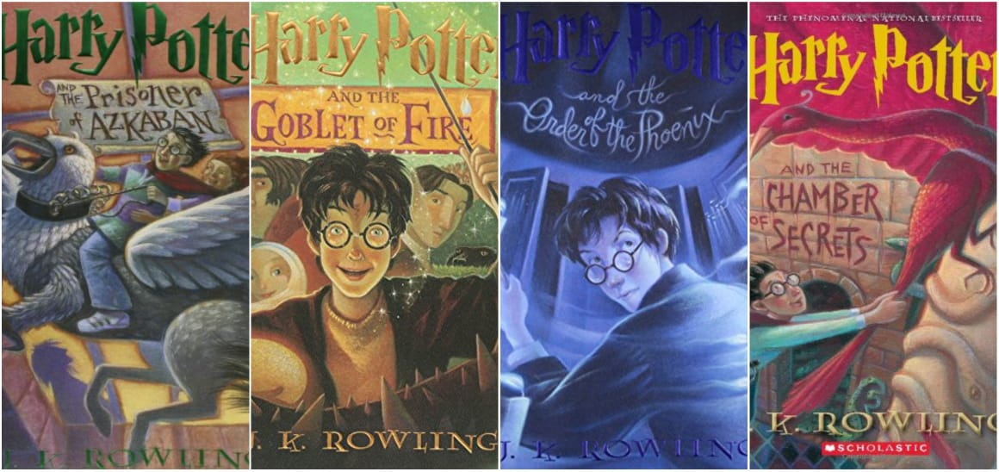

<font color='blue'>Thats Great!!

#Collaborative Filtering based Recommendation System--(User-Item based)

In [ ]:
ratings_explicit.head()
ratings_explicit.rename(columns={'user_id':'User-ID','isbn':'ISBN','book_rating':'Book-Rating'},inplace=True)

In [ ]:
ratings_explicit.head()

,ISBN,User-ID,Book-Rating,Avg_Rating,Total_No_Of_Users_Rated
0,0002005018,8,5,7.667,9
1,074322678X,8,5,5.000,1
2,0887841740,8,5,5.000,1
3,1552041778,8,5,5.000,1
4,1567407781,8,6,6.000,1


In [ ]:

users_interactions_count_df = ratings_explicit.groupby(['ISBN', 'User-ID']).size().groupby('User-ID').size()
print('# of users: %d' % len(users_interactions_count_df))

users_with_enough_interactions_df = users_interactions_count_df[users_interactions_count_df >= 100].reset_index()[['User-ID']]
print('# of users with at least 5 interactions: %d' % len(users_with_enough_interactions_df))

# of users: 68091
# of users with at least 5 interactions: 449


In [ ]:
print('# of interactions: %d' % len(ratings_explicit))
interactions_from_selected_users_df = ratings_explicit.merge(users_with_enough_interactions_df, 
               how = 'right',
               left_on = 'User-ID',
               right_on = 'User-ID')
print('# of interactions from users with at least 5 interactions: %d' % len(interactions_from_selected_users_df))

# of interactions: 383892
# of interactions from users with at least 5 interactions: 103286


In [ ]:
interactions_from_selected_users_df.head(10)

,ISBN,User-ID,Book-Rating,Avg_Rating,Total_No_Of_Users_Rated
0,0142000663,2033,10,8.457,35
1,0836218256,2033,9,8.941,17
2,0030020786,2033,7,7.000,1
3,0133502813,2033,10,10.000,1
4,0716724022,2033,7,7.000,1
5,0060256664,2033,10,8.333,6
6,0786861320,2033,8,8.000,1
7,0688149790,2033,8,7.600,15
8,0671519751,2033,10,7.500,4
9,0812090381,2033,9,9.000,1


In [ ]:
import math

In [ ]:
def smooth_user_preference(x):
    return math.log(1+x, 2)
    
interactions_full_df = interactions_from_selected_users_df.groupby(['ISBN', 'User-ID'])['Book-Rating'].sum().apply(smooth_user_preference).reset_index()
print('# of unique user/item interactions: %d' % len(interactions_full_df))
interactions_full_df.head()

# of unique user/item interactions: 103271


,ISBN,User-ID,Book-Rating
0,0000913154,171118,3.170
1,0001046438,23902,3.322
2,000104687X,23902,2.807
3,0001047213,23902,3.322
4,0001047973,23902,3.322


In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
interactions_train_df, interactions_test_df = train_test_split(interactions_full_df,
                                   stratify=interactions_full_df['User-ID'], 
                                   test_size=0.20,
                                   random_state=42)

print('# interactions on Train set: %d' % len(interactions_train_df))
print('# interactions on Test set: %d' % len(interactions_test_df))

# interactions on Train set: 82616
# interactions on Test set: 20655


In [ ]:
interactions_test_df.head()

,ISBN,User-ID,Book-Rating
87596,0879051213,95010,3.000
52630,0515101230,129074,3.000
68434,0679427724,75819,3.170
85835,0843951346,135149,3.322
92752,1551665727,158295,3.170


In [ ]:
#Creating a sparse pivot table with users in rows and items in columns
users_items_pivot_matrix_df = interactions_train_df.pivot(index='User-ID', 
                                                          columns='ISBN', 
                                                          values='Book-Rating').fillna(0)

users_items_pivot_matrix_df.head()

ISBN,0000913154,000104687X,0001047213,0001047973,000104799X,0001048082,0001053736,0001055607,0001056107,0001845039,0001935968,0001944711,0001953877,0002000547,0002005018,0002005050,0002005557,0002006588,0002115328,0002116286,0002118580,0002154900,0002158973,0002163713,0002176181,0002176432,0002179695,0002181924,0002184974,0002190915,0002197154,0002223929,0002228394,000223257X,0002239183,0002240114,0002241358,0002245728,000225056X,0002250810,0002251000,0002251760,0002252341,0002252376,0002258560,000225929X,0002259877,0002316196,0002317141,0002325780,0002550563,0002551675,0002555565,0002558122,0002558661,0002712172,0002726874,0004125576,0004133439,0004334787,000433549X,0004356373,0004588010,0004588177,0004701674,0004702816,0004704746,0004704754,0004704932,0004708105,0004709721,000470973X,0004720695,0004722124,0004723708,0004724097,000611962X,0006131409,0006143199,0006156487,0006157629,0006166598,0006171982,0006174841,0006176747,0006176992,0006177492,0006178316,0006280803,0006363113,0006363121,0006365744,0006366023,0006370039,0006370829,0006371248,0006372899,0006375952,0006380263,0006380921,0006380964,0006383777,0006384684,0006384854,0006385370,0006385648,0006386369,0006472648,000647425X,0006480608,000648302X,0006485200,0006485936,0006490603,0006492126,0006492347,000649840X,0006498493,000651202X,0006512062,0006514952,0006531407,0006542808,0006546684,0006547486,0006547613,0006547753,0006547834,0006548539,0006548830,0006550061,0006550789,0006550924,0006551076,0006552390,0006726143,0006729835,000673765X,0006742939,0006742947,0006940889,0007100108,0007100930,0007102216,000710331X,0007103867,0007105150,0007105665,0007106572,000710698X,0007107900,0007110200,0007110227,0007110928,0007114788,000711737X,0007118465,0007119070,0007119860,0007122039,0007122861,0007127936,0007128568,0007128576,0007139411,0007141076,0007144172,0007144350,000715111X,0007154607,0007154615,000716226X,0007164076,0007176023,000764065X,0020009607,0020016700,0020088248,0020093616,0020103514,002011690X,0020125305,0020125607,0020154402,0020155506,0020182104,0020188706,0020197802,0020198817,0020198841,0020198906,0020199031,0020199600,0020199856,0020209851,0020223412,0020223722,0020225601,0020259913,0020264763,002026478X,0020264801,0020280505,002028361X,0020296703,0020296800,0020299605,0020303750,0020306652,0020315902,0020322208,0020332858,002036041X,002038260X,0020383142,002040400X,0020407009,0020412401,0020413904,0020415133,0020419805,0020426801,0020427018,0020427107,0020427115,0020427859,0020434804,0020434901,0020442009,0020442106,0020442203,0020442300,0020442408,0020442505,0020442602,0020442807,0020444206,0020446500,0020449313,0020452705,0020474105,002047430X,0020518307,0020518501,0020518609,0020518706,0020518803,0020519001,0020519605,0020532105,0020545304,002054720X,0020583516,0020631502,0020633505,0020698461,0020715609,0020720203,0020778201,0020780605,0020811608,0020811853,0020820445,0020868308,0020868901,0020869002,002086910X,0020869509,0020869606,002089130X,0020931808,002097292X,0023018909,0023060956,002322410X,0023381205,0023401354,0023582901,0023635703,002363880X,0023795808,0023886854,0023895306,0024040908,0024096903,0024103411,002411510X,0024182001,0025074857,002517990X,0025196359,0025225804,0025226207,0025386700,002542730X,0025430807,0025439456,0025439472,0025444506,0025606115,0025876007,0025953621,0026024306,0026128101,0026205408,0026217457,0026258102,0026305909,0026638959,0026888130,0027110206,0027110400,0027110559,002711080X,0027118401,0027136701,0027136809,0027153800,0027183505,0027345459,0027359409,0027434850,0027436292,0027582000,0027617319,0027627403,0027701301,0027757315,0027778800,0027826902,0027859002,0027887901,0027916405,0028025008,0028603702,0028603869,0028603923,0028603958,0028604032,0028604199,0028604202,0028604458,0028604792,0028604954,0028604997,0028608127,0028608364,0028608437,0028610105,0028610407,0028610415,0028610741,0028612787,0028612922,0028613228,0028614496,0028615689,0028615972,0028616367,0028616375,0028617274,0028617363,0028617452,00

In [ ]:
users_items_pivot_matrix = users_items_pivot_matrix_df.values
users_items_pivot_matrix[:10]

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
users_ids = list(users_items_pivot_matrix_df.index)
users_ids[:10]

[2033, 2110, 2276, 4017, 4385, 5582, 6242, 6251, 6543, 6575]

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
from scipy.sparse.linalg import svds

In [ ]:
# The number of factors to factor the user-item matrix.
NUMBER_OF_FACTORS_MF = 15

#Performs matrix factorization of the original user item matrix
U, sigma, Vt = svds(users_items_pivot_matrix, k = NUMBER_OF_FACTORS_MF)

In [ ]:
users_items_pivot_matrix.shape

(449, 55726)

In [ ]:
U.shape

(449, 15)

In [ ]:
sigma = np.diag(sigma)
sigma.shape

(15, 15)

In [ ]:
Vt.shape

(15, 55726)

<font color='blue'>After the factorization, we try to to reconstruct the original matrix by multiplying its factors. The resulting matrix is not sparse any more. It was generated predictions for items the user have not yet interaction, which we will exploit for recommendations.

In [ ]:
all_user_predicted_ratings = np.dot(np.dot(U, sigma), Vt) 

In [ ]:
all_user_predicted_ratings.shape

(449, 55726)

In [ ]:
#Converting the reconstructed matrix back to a Pandas dataframe
cf_preds_df = pd.DataFrame(all_user_predicted_ratings, columns = users_items_pivot_matrix_df.columns, index=users_ids).transpose()
cf_preds_df.head()

,2033,2110,2276,4017,4385,5582,6242,6251,6543,6575,7286,7346,8067,8245,8681,8890,10560,11676,11993,12538,12824,12982,13552,13850,14422,15408,15418,16634,16795,16966,17950,19085,21014,23768,23872,23902,25409,25601,25981,26535,26544,26583,28591,28634,29259,30276,30511,30711,30735,30810,31315,31556,31826,32773,33145,35433,35836,35857,35859,36299,36554,36606,36609,36836,36907,37644,37712,37950,38023,38273,38281,39281,39467,40889,40943,43246,43910,46398,47316,48025,48494,49144,49889,51883,52199,52350,52584,52614,52917,53220,55187,55490,55492,56271,56399,56447,56554,56959,59172,60244,60337,60707,63714,63956,65258,66942,67840,68555,69078,69389,69697,70415,70594,70666,72352,73681,75591,75819,76151,76223,76499,76626,78553,78783,78834,78973,79441,81492,81560,83287,83637,83671,85526,85656,86189,86947,87141,87555,88283,88677,88693,88733,89602,91113,92652,92810,93047,93363,93629,94242,94347,94853,94951,95010,95359,95902,95932,96448,97754,97874,98391,98758,100459,100906,101209,101606,101851,102359,102647,102702,102967,104399,104636,105028,105517,105979,106007,107784,107951,109574,109901,109955,110483,110912,110934,110973,112001,113270,113519,114368,114868,114988,115002,115003,116599,117384,120565,122429,122793,123094,123608,123883,123981,125519,125774,126492,126736,127200,127359,128835,129074,129716,129851,130554,130571,132492,132836,133747,134434,135149,135265,136010,136139,136348,136382,138578,138844,140000,140358,141902,142524,143175,143253,143415,145449,146113,146348,147847,148199,148258,148744,148966,149907,149908,150979,153662,156150,156269,156300,156467,157247,157273,158226,158295,158433,159506,160295,162052,162639,162738,163759,163761,163804,163973,164096,164323,164533,164828,164905,165308,165319,165758,166123,166596,168047,168245,169682,170513,170634,171118,172030,172742,172888,173291,173415,174304,174892,177072,177432,177458,178522,179718,179978,180378,180651,181176,182085,182086,182993,183958,183995,184299,184532,185233,185384,187145,187256,187517,189139,189334,189835,189973,190708,190925,193458,193560,193898,194600,196077,196160,196502,197659,199416,200226,201290,203240,204864,205735,205943,206534,207782,208406,208671,209516,210485,211426,211919,212965,214786,216012,216444,216683,217106,217318,217740,218552,218608,219546,219683,222204,222296,223087,223501,224349,224525,224646,224764,225087,225199,225232,225595,225763,226965,227250,227447,227520,227705,229011,229329,229551,229741,230522,231210,232131,232945,233911,234359,234828,235105,235282,235935,236058,236283,236340,236757,236948,239584,239594,240144,240403,240543,240567,240568,241198,241666,241980,242006,242083,242409,242465,244627,244685,245410,245827,246311,247429,247447,248718,249894,250405,250709,251394,251843,251844,252695,252820,254206,254465,254899,255489,257204,258152,258185,258534,261105,261829,262998,264031,264082,264321,264525,265115,265313,265889,266056,266226,268110,268300,268932,269566,270713,271448,271705,273113,274061,274301,275970,277427,278418
ISBN,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000913154,0.015,-0.001,-0.002,0.001,-0.002,-0.004,-0.003,0.007,0.001,0.013,-0.001,0.021,-0.004,-0.005,-0.004,-0.000,0.016,-0.001,0.007,0.008,0.003,-0.006,-0.023,0.010,-0.004,0.005,0.010,0.044,0.010,0.015,-0.001,-0.003,-0.004,-0.001,0.007,-0.003,-0.000,0.005,-0.007,-0.001,0.003,-0.001,-0.003,-0.010,0.000,-0.007,0.005,0.002,-0.001,-0.000,-0.016,0.032,-0.037,0.003,-0.000,-0.000,-0.003,-0.003,-0.009,0.043,-0.000,-0.007,-0.003,-0.001,0.012,0.008,0.011,-0.001,0.003,0.025,-0.003,-0.003,0.008,-0.005,0.006,0.015,-0.003,0.006,-0.004,-0.002,0.001,-0.000,0.006,-0.006,-0.004,0.004,0.00

In [ ]:
len(cf_preds_df.columns)

449

In [ ]:
global books
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company


In [ ]:
class CFRecommender:
    
    MODEL_NAME = 'Collaborative Filtering'
    
    def __init__(self, cf_predictions_df):
        self.cf_predictions_df = cf_predictions_df
        
    def get_model_name(self):
        return self.MODEL_NAME
        
    def recommend_items(self, user_id, items_to_ignore=[], topn=10):
        # Get and sort the user's predictions
        sorted_user_predictions = self.cf_predictions_df[user_id].sort_values(ascending=False).reset_index().rename(columns={user_id: 'recStrength'})

        # Recommend the highest predicted rating content that the user hasn't seen yet.
        recommendations_df = sorted_user_predictions[~sorted_user_predictions['ISBN'].isin(items_to_ignore)].sort_values('recStrength', ascending = False).head(topn)
        recommendations_df=recommendations_df.merge(books,on='ISBN',how='inner')
        recommendations_df=recommendations_df[['ISBN','Book-Title','recStrength']]

        return recommendations_df



cf_recommender_model = CFRecommender(cf_preds_df)

In [ ]:
#Indexing by personId to speed up the searches during evaluation
interactions_full_indexed_df = interactions_full_df.set_index('User-ID')
interactions_train_indexed_df = interactions_train_df.set_index('User-ID')
interactions_test_indexed_df = interactions_test_df.set_index('User-ID')

In [ ]:
def get_items_interacted(UserID, interactions_df):
    interacted_items = interactions_df.loc[UserID]['ISBN']
    return set(interacted_items if type(interacted_items) == pd.Series else [interacted_items])

In [ ]:
class ModelRecommender:

    # Function for getting the set of items which a user has not interacted with
    def get_not_interacted_items_sample(self, UserID, sample_size, seed=42):
        interacted_items = get_items_interacted(UserID, interactions_full_indexed_df)
        all_items = set(ratings_explicit['ISBN'])
        non_interacted_items = all_items - interacted_items

        random.seed(seed)
        non_interacted_items_sample = random.sample(non_interacted_items, sample_size)
        return set(non_interacted_items_sample)

    # Function to verify whether a particular item_id was present in the set of top N recommended items
    def _verify_hit_top_n(self, item_id, recommended_items, topn):        
            try:
                index = next(i for i, c in enumerate(recommended_items) if c == item_id)
            except:
                index = -1
            hit = int(index in range(0, topn))
            return hit, index
    
    # Function to evaluate the performance of model for each user
    def evaluate_model_for_user(self, model, person_id):
        
        # Getting the items in test set
        interacted_values_testset = interactions_test_indexed_df.loc[person_id]
        
        if type(interacted_values_testset['ISBN']) == pd.Series:
            person_interacted_items_testset = set(interacted_values_testset['ISBN'])
        else:
            person_interacted_items_testset = set([int(interacted_values_testset['ISBN'])])
            
        interacted_items_count_testset = len(person_interacted_items_testset) 

        # Getting a ranked recommendation list from the model for a given user
        person_recs_df = model.recommend_items(person_id, items_to_ignore=get_items_interacted(person_id, interactions_train_indexed_df),topn=10000000000)
        print('Recommendation for User-ID = ',person_id)
        print(person_recs_df.head(10))

        # Function to evaluate the performance of model at overall level
    def recommend_book(self, model ,userid):
        
        person_metrics = self.evaluate_model_for_user(model, userid)  
        return

model_recommender = ModelRecommender()    

<font color='blue'>**Let's recommend books to User-Id 69078 and see the results.**

In [ ]:
#print(list(interactions_full_indexed_df.index.values))

In [ ]:
user=int(input("Enter User ID from above list for book recommendation  "))
model_recommender.recommend_book(cf_recommender_model,user)

Enter User ID from above list for book recommendation  4017
Recommendation for User-ID =  4017
         ISBN                                         Book-Title  recStrength
0  0312966970             Four To Score (A Stephanie Plum Novel)        0.272
1  0440214041                                  The Pelican Brief        0.267
2  0345370775                                      Jurassic Park        0.266
3  0316769487                             The Catcher in the Rye        0.266
4  0345361792                            A Prayer for Owen Meany        0.245
5  0671003755  She's Come Undone (Oprah's Book Club (Paperback))        0.241
6  0440226430                                     Summer Sisters        0.238
7  0385504209                                  The Da Vinci Code        0.236
8  0312195516                The Red Tent (Bestselling Backlist)        0.235
9  044021145X                                           The Firm        0.211


#**Evaluation Metrics**
In Recommender Systems, there are a set metrics commonly used for evaluation. We choose to work with **Top-N accuracy metrics**, which evaluates the accuracy of the top recommendations provided to a user, comparing to the items the user has actually interacted in test set.

This evaluation method works as follows:

* For each user
    * For each item the user has interacted in test set
        * Sample 100 other items the user has never interacted.   
        * Ask the recommender model to produce a ranked list of recommended items, from a set composed of one interacted item and the 100 non-interacted items
        * Compute the Top-N accuracy metrics for this user and interacted item from the recommendations ranked list
* Aggregate the global Top-N accuracy metrics

In [ ]:
from random import *

In [ ]:
#Top-N accuracy metrics consts
EVAL_RANDOM_SAMPLE_NON_INTERACTED_ITEMS = 100

class ModelEvaluator:

    # Function for getting the set of items which a user has not interacted with
    def get_not_interacted_items_sample(self, UserID, sample_size, seed=42):
        interacted_items = get_items_interacted(UserID, interactions_full_indexed_df)
        all_items = set(ratings_explicit['ISBN'])
        non_interacted_items = all_items - interacted_items

        random.seed(42)
        non_interacted_items_sample = random.sample(non_interacted_items, sample_size)
        return set(non_interacted_items_sample)

    # Function to verify whether a particular item_id was present in the set of top N recommended items
    def _verify_hit_top_n(self, item_id, recommended_items, topn):        
            try:
                index = next(i for i, c in enumerate(recommended_items) if c == item_id)
            except:
                index = -1
            hit = int(index in range(0, topn))
            return hit, index
    
    # Function to evaluate the performance of model for each user
    def evaluate_model_for_user(self, model, person_id):
        
        # Getting the items in test set
        interacted_values_testset = interactions_test_indexed_df.loc[person_id]
        
        if type(interacted_values_testset['ISBN']) == pd.Series:
            person_interacted_items_testset = set(interacted_values_testset['ISBN'])
        else:
            person_interacted_items_testset = set([int(interacted_values_testset['ISBN'])])
            
        interacted_items_count_testset = len(person_interacted_items_testset) 

        # Getting a ranked recommendation list from the model for a given user
        person_recs_df = model.recommend_items(person_id, items_to_ignore=get_items_interacted(person_id, interactions_train_indexed_df),topn=10000000000)

        hits_at_5_count = 0
        hits_at_10_count = 0
        
        # For each item the user has interacted in test set
        for item_id in person_interacted_items_testset:
            
            # Getting a random sample of 100 items the user has not interacted with
            non_interacted_items_sample = self.get_not_interacted_items_sample(person_id, sample_size=EVAL_RANDOM_SAMPLE_NON_INTERACTED_ITEMS, seed=item_id)    #%(2**32))

            # Combining the current interacted item with the 100 random items
            items_to_filter_recs = non_interacted_items_sample.union(set([item_id]))

            # Filtering only recommendations that are either the interacted item or from a random sample of 100 non-interacted items
            valid_recs_df = person_recs_df[person_recs_df['ISBN'].isin(items_to_filter_recs)]                    
            valid_recs = valid_recs_df['ISBN'].values
            
            # Verifying if the current interacted item is among the Top-N recommended items
            hit_at_5, index_at_5 = self._verify_hit_top_n(item_id, valid_recs, 5)
            hits_at_5_count += hit_at_5
            hit_at_10, index_at_10 = self._verify_hit_top_n(item_id, valid_recs, 10)
            hits_at_10_count += hit_at_10

        # Recall is the rate of the interacted items that are ranked among the Top-N recommended items
        recall_at_5 = hits_at_5_count / float(interacted_items_count_testset)
        recall_at_10 = hits_at_10_count / float(interacted_items_count_testset)

        person_metrics = {'hits@5_count':hits_at_5_count, 
                          'hits@10_count':hits_at_10_count, 
                          'interacted_count': interacted_items_count_testset,
                          'recall@5': recall_at_5,
                          'recall@10': recall_at_10}
        return person_metrics

    
    # Function to evaluate the performance of model at overall level
    def evaluate_model(self, model):
        
        people_metrics = []
        
        for idx, person_id in enumerate(list(interactions_test_indexed_df.index.unique().values)):    
            person_metrics = self.evaluate_model_for_user(model, person_id)  
            person_metrics['User-ID'] = person_id
            people_metrics.append(person_metrics)
            
        print('%d users processed' % idx)

        detailed_results_df = pd.DataFrame(people_metrics).sort_values('interacted_count', ascending=False)
        
        global_recall_at_5 = detailed_results_df['hits@5_count'].sum() / float(detailed_results_df['interacted_count'].sum())
        global_recall_at_10 = detailed_results_df['hits@10_count'].sum() / float(detailed_results_df['interacted_count'].sum())
        
        global_metrics = {'modelName': model.get_model_name(),
                          'recall@5': global_recall_at_5,
                          'recall@10': global_recall_at_10}    
        return global_metrics, detailed_results_df
    
model_evaluator = ModelEvaluator()    

In [ ]:
print('Evaluating Collaborative Filtering (SVD Matrix Factorization) model...')
cf_global_metrics, cf_detailed_results_df = model_evaluator.evaluate_model(cf_recommender_model)

In [ ]:
print('\nGlobal metrics:\n%s' % cf_global_metrics)
cf_detailed_results_df.head(10)


Global metrics:
{'modelName': 'Collaborative Filtering', 'recall@5': 0.23815056886952313, 'recall@10': 0.30355846042120554}


,hits@5_count,hits@10_count,interacted_count,recall@5,recall@10,User-ID
10,261,333,1389,0.188,0.240,11676
31,191,234,1138,0.168,0.206,98391
45,24,28,380,0.063,0.074,189835
30,84,101,369,0.228,0.274,153662
70,30,36,236,0.127,0.153,23902
7,29,46,204,0.142,0.225,235105
47,24,31,203,0.118,0.153,76499
50,28,38,193,0.145,0.197,171118
42,62,70,192,0.323,0.365,16795
43,21,31,188,0.112,0.165,248718


**<h1>Conclusion**</br>
1. In EDA, the Top-10 most rated books were essentially novels. Books like The Lovely Bone and Wild Animus were very well perceived
2. Majority of the readers were of the age bracket 20-40 and most of them came from North American and European countries namely USA, Canada, UK, Germany and Spain. 
3. If we look at the ratings distribution, most of the books have high ratings with maximum books being rated 8. Ratings below 5 are few in number. 
4. Author with the most books was Agatha Christie, William Shakespeare and Stephen King. 
5. Amongst the memory based approach, User-item CF performed because of lower computation .

